Importing required packages

In [1]:
import numpy as np
import pandas as pd
import os
from pathlib import Path
import shutil
import matplotlib.pyplot as plt
from pyproj import Proj
#Variables from configuration files
import config

ProcessedPath = config.SavePath
GROUPS = config.GROUPS


Finding Out the groups which have the maximum days of coverage

In [2]:
max_days = {}
for j in GROUPS:
    
    SavePath = ProcessedPath + str(j) + '/GPS_Days/'
    paths = os.listdir(SavePath)
    date,ind= [],[]
    for i in paths:
        data =  pd.read_csv(SavePath + '/'+ i ,index_col=0)
        
        date.append(i)
        ind.append(len(data['Individual'].unique()))
    max_item = max(ind)
    if max_item>=4:
        index_list = [date[index] for index in range(len(ind)) if ind[index] == max_item]
        max_days[j] = [index_list,max_item]

max_days
    

{'NQ_2021_1': [['2021-08-11', '2021-08-12'], 5],
 'ZU_2021_1': [['2021-05-18',
   '2021-05-19',
   '2021-05-20',
   '2021-05-21',
   '2021-05-22'],
  6],
 'ZU_2021_2': [['2021-07-21', '2021-07-22'], 4]}

Choosing a specific day, and defining a function to convert coordinates to UTM units using the following parameters (zone=34,ellps='WGS84',south=True)

In [3]:
k = 'ZU_2021_1'
j = '2021-05-16'
def sync_gps_simultaneous(data,k,j):
    print('Duration of data',data.shape[0])
    data['Timestamp'] = pd.to_datetime(data['Timestamp'])
    df =  data.groupby('Timestamp')
    dfnew = df.filter(lambda x: len(x['Individual'].unique())>=5)
    
    pp = Proj(proj='utm',zone=34,ellps='WGS84',south=True)

    xx, yy = pp(dfnew["lon"].values,dfnew["lat"].values)
    dfnew["X"] = xx
    dfnew["Y"] = yy 

    
    dfnew = dfnew.reset_index(drop=True)
    
    times = sorted(dfnew['Timestamp'].unique())
    time_start = times[0]
    time_end = times[-1]

    time_start = time_start + pd.Timedelta(seconds=30)
    time_end = time_end - pd.Timedelta(seconds=30)

    dfnew = dfnew.loc[(dfnew['Timestamp']>=time_start) & (dfnew['Timestamp']<=time_end)] 
    if j == '2021-05-18':  
        print('Seconds removed: ',len(dfnew.loc[((dfnew['X']<581950) & (dfnew['Y']>(7.02035e6)))]))
        dfnew = dfnew.loc[~((dfnew['X']<581950) & (dfnew['Y']>(7.02035e6)))] #for 3 erroneous points on '2021-05-18', remove for others
    
    else:
        pass
    dfnew=dfnew.reset_index(drop=True)
    
    print('Duration of Simultaneous data',dfnew.shape[0])
    return dfnew

Plotting a specific day to check the above defined function

Duration of data 54271
Seconds removed:  3
Duration of Simultaneous data 53206


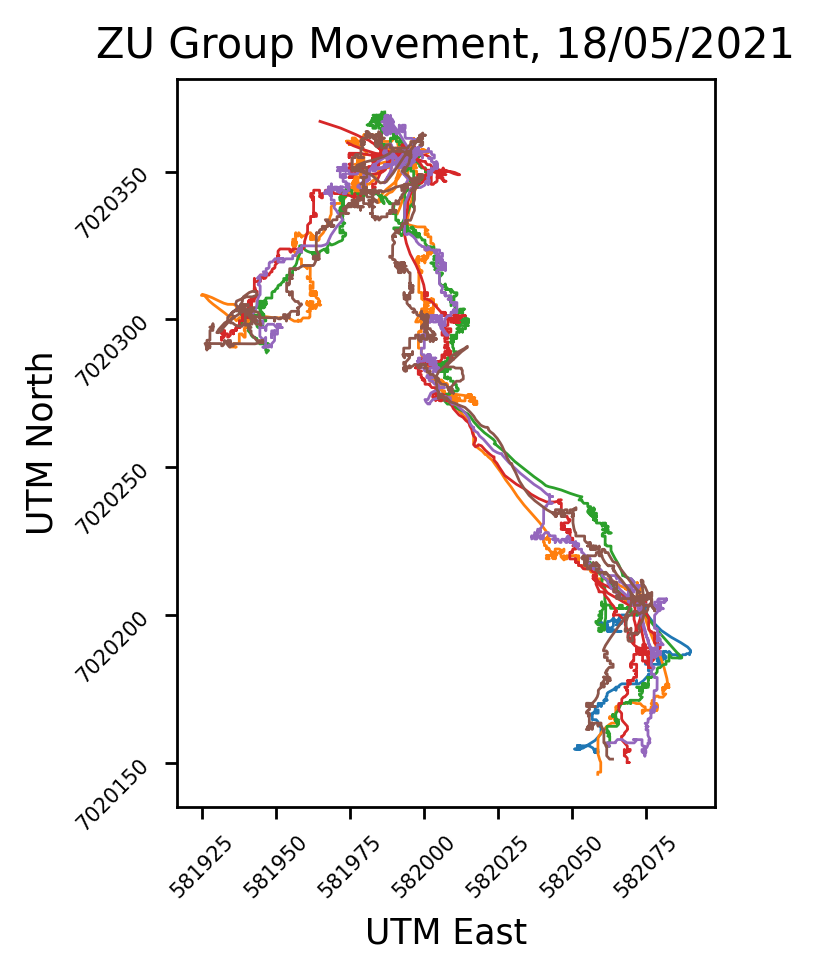

In [4]:
k = 'ZU_2021_1' #ZGroups
j = '2021-05-18' #Day
fig,ax= plt.subplots(dpi=250)
data = pd.read_csv(ProcessedPath + str(k) + '/GPS_Days/'+ j,index_col=0)
data = sync_gps_simultaneous(data,k,j)

for ind in data['Individual'].unique():
    x = data.loc[data['Individual']==ind,'X']#.rolling(center=True,window=3).mean()
    y = data.loc[data['Individual']==ind,'Y']#.rolling(center=True,window=3).mean()
    ax.set_xlabel('UTM East')
    ax.set_ylabel('UTM North')
    ax.set_title('ZU Group Movement, 18/05/2021')
    ax.grid()
    ax.set_aspect('equal')
    ax.tick_params(axis='x', labelsize=6,rotation=45)
    ax.tick_params(axis='y', labelsize=6,rotation=45)
    #ax.legend(prop=dict(size=12))
    
    plt.plot(x,y,label=ind,linewidth=0.8)
ax.ticklabel_format(useOffset=False,style='plain')
#plt.legend(fontsize = 6)
plt.tight_layout()
plt.savefig('GPS_Movements.pdf')
plt.show()

# Space Discrete

In [5]:
times = sorted(data['Timestamp'].unique())
discrete_space_times,centroid_pos = [times[0]],[]
space_step = 10
prev_pos = data.loc[data['Timestamp'] == times[0]].dropna()
for time in times[1:]:
    prev_centroid = np.sum(prev_pos[['X','Y']],axis=0)/prev_pos.shape[0]
    new_pos = data.loc[data['Timestamp'] == time].dropna()
    new_centroid = np.sum(new_pos[['X','Y']],axis=0)/new_pos.shape[0]
    
    if np.sqrt(np.sum((new_centroid - prev_centroid)**2)) >= space_step:
        prev_pos = new_pos.dropna()
        discrete_space_times.append(time)
        centroid_pos.append(new_centroid)
    else:
        pass
discrete_space_times = [pd.to_datetime(i) for i in discrete_space_times]

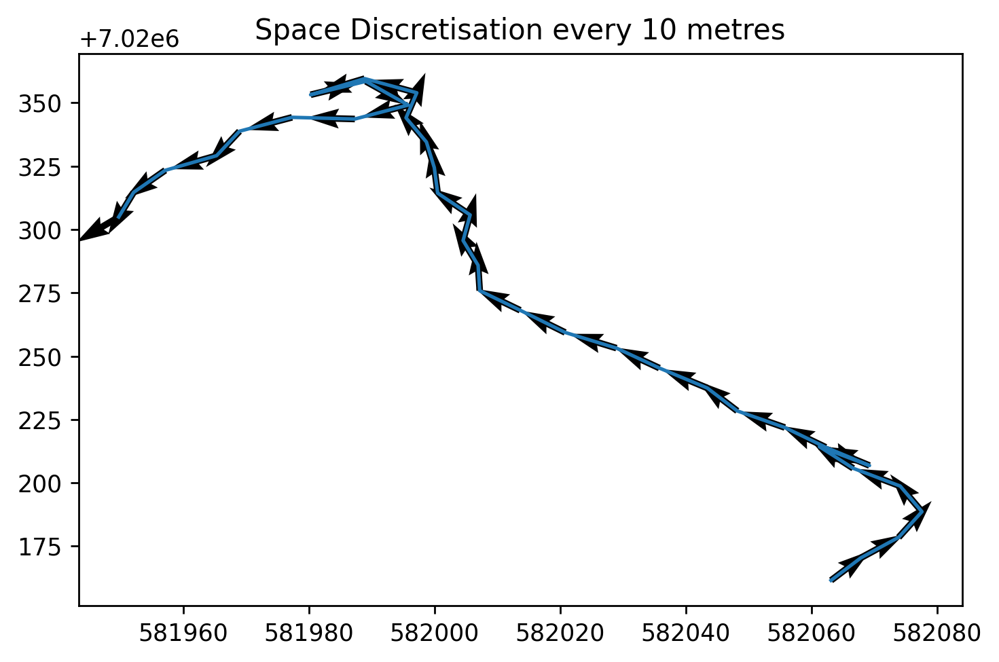

In [6]:
centroid_mov =pd.DataFrame()
centroid_mov['Timestamp'] = discrete_space_times[:-1]
centroid_mov['Centroid_X'] = [i[0] for i in centroid_pos]
centroid_mov['Centroid_Y'] = [i[1] for i in centroid_pos]
dirs = [(centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3]) / np.sqrt(np.sum((centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3])**2))  for i in range(centroid_mov.shape[0]-1) ]
centroid_mov = centroid_mov.iloc[0:-1,:]
centroid_mov['Dir_X'] = [i[0] for i in dirs]
centroid_mov['Dir_Y'] = [i[1] for i in dirs]

fig,ax= plt.subplots(dpi=250)
#ax.set_aspect('equal')
plt.title('Space Discretisation every ' + str(space_step) + ' metres')
ax.plot(centroid_mov.iloc[:,1],centroid_mov.iloc[:,2])
ax.quiver(centroid_mov.iloc[:,1],centroid_mov.iloc[:,2],centroid_mov.iloc[:,3],centroid_mov.iloc[:,4],angles='xy')
plt.tight_layout()
plt.show()

Relative Position and axis rotation

In [7]:
data_discrete =  data.set_index('Timestamp').loc[centroid_mov['Timestamp']].reset_index()
data_discrete = data_discrete.replace([np.inf, -np.inf], np.nan)
data_discrete = data_discrete.dropna(axis=0).reset_index(drop=True)

data_discrete = data_discrete.drop(['lat','lon','height-msl'],axis=1)
corrected_data_discrete = pd.DataFrame()
for time in data_discrete['Timestamp'].unique():
    
    group_data = data_discrete.loc[data_discrete['Timestamp']==time]
    centroid_data = centroid_mov.loc[centroid_mov['Timestamp']==time]
    new_df =group_data.loc[:,['Timestamp','Behavior','Individual']]
    new_df['Rel_X'] = group_data['X'] - centroid_data['Centroid_X'].values
    new_df['Rel_Y'] = group_data['Y'] - centroid_data['Centroid_Y'].values
    
    direction_angle = np.arctan(( centroid_data['Dir_Y']/ centroid_data['Dir_X']).values)
    Rel_X = new_df['Rel_X']*np.cos(direction_angle) - new_df['Rel_Y']*np.sin(direction_angle)
    Rel_Y = new_df['Rel_X']*np.sin(direction_angle) + new_df['Rel_Y']*np.cos(direction_angle)
    new_df['Rel_X'] = Rel_X
    new_df['Rel_Y'] = Rel_Y
    new_df['X_zscore'] = (new_df['Rel_X'] - np.mean(new_df['Rel_X'])) / np.std(new_df['Rel_X']) 
    new_df['Y_zscore'] = (new_df['Rel_Y'] - np.mean(new_df['Rel_Y'])) / np.std(new_df['Rel_Y']) 
    
    corrected_data_discrete = pd.concat([corrected_data_discrete,new_df],axis=0)

In [8]:
corrected_data_discrete

,Timestamp,Behavior,Individual,Rel_X,Rel_Y,X_zscore,Y_zscore
0,2021-05-18 08:06:30,Foraging,VZUM056,4.900200,-7.487851,-1.078332,-0.586660
1,2021-05-18 08:06:30,Vigilance,VZUF051,11.391880,-11.007634,0.873692,-1.560151
2,2021-05-18 08:06:30,Vigilance,VZUF054,12.553481,-0.344295,1.222981,1.389082
3,2021-05-18 08:06:30,Vigilance,VZUM053,4.372304,-3.813677,-1.237068,0.429531
4,2021-05-18 08:06:30,Vigilance,VZUM059,9.213716,-4.180056,0.218726,0.328199
...,...,...,...,...,...,...,...
178,2021-05-18 10:41:08,Foraging,VZUF051,-5.488260,15.635838,0.296242,1.484507
179,2021-05-18 10:41:08,Foraging,VZUF052,-5.152709,6.981163,0.376216,-0.079483
180,2021-05-18 10:41:08,Foraging,VZUF054,-10.460212,-1.417042,-0.888753,-1.597126
181,2021-05-18 10:41:08,Foraging,VZUM053,-12.179498,9.790582,-1.298521,0.428208


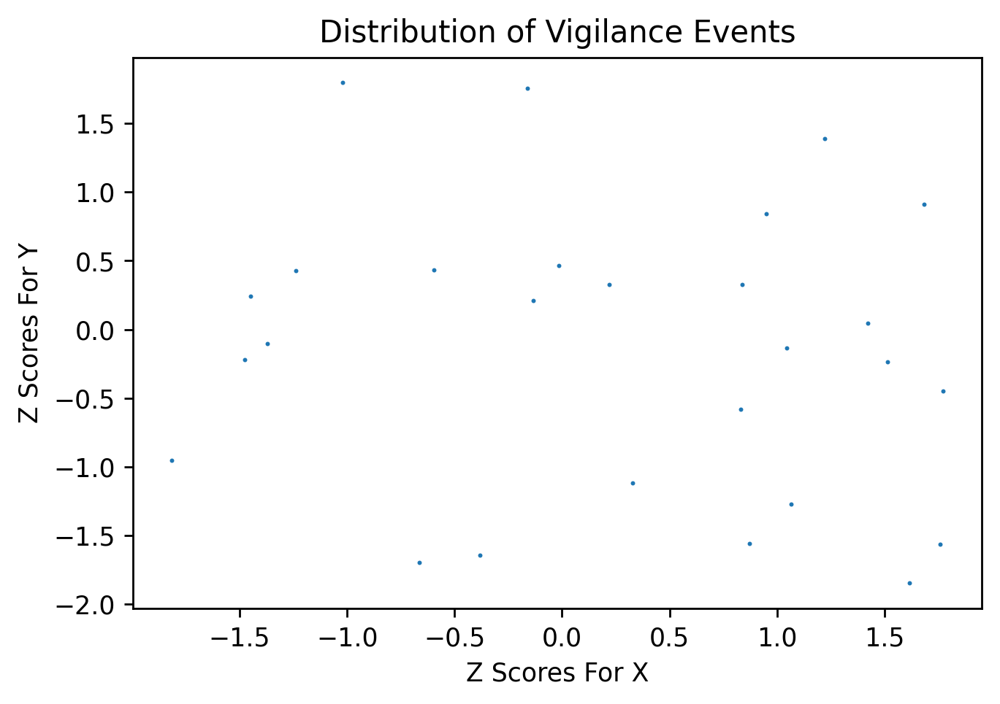

In [9]:
fig,ax= plt.subplots(dpi=250)
ax.set_title('Distribution of Vigilance Events')
ax.set_xlabel('Z Scores For X')
ax.set_ylabel('Z Scores For Y')
vig_data = corrected_data_discrete[corrected_data_discrete['Behavior']=='Vigilance']
ax.scatter(vig_data['X_zscore'],vig_data['Y_zscore'],s=0.5)

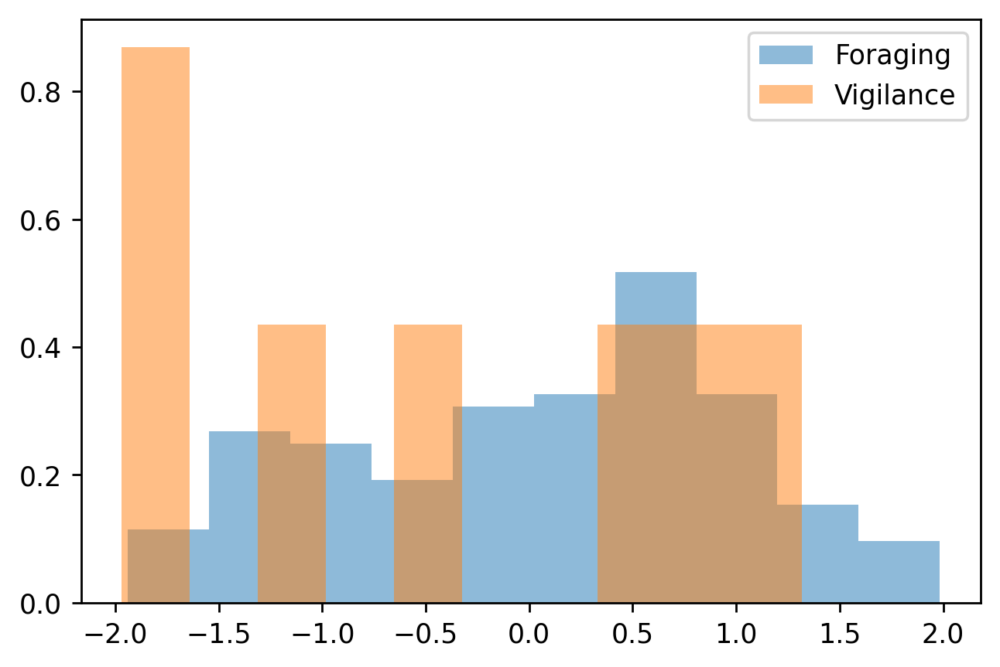

In [ ]:
fig,ax= plt.subplots(dpi=250)
forage_data = corrected_data_discrete[corrected_data_discrete['Behavior']=='Foraging']
vig_data = corrected_data_discrete[corrected_data_discrete['Behavior']=='Vigilance']
ax.hist(forage_data['Y_zscore'],density=True,alpha=0.5,label="Foraging")
ax.hist(vig_data['Y_zscore'],density=True,alpha=0.5,label="Vigilance")
ax.legend()
plt.show()

In [10]:


def space_discrete(data,step):
    times = sorted(data['Timestamp'].unique())
    print(times[0])
    print('\n')
    discrete_space_times,centroid_pos = [times[0]],[]
    #Spatial Discretization
    space_step = step
    prev_pos = data.loc[data['Timestamp'] == times[0]].dropna()
    for time in times[1:]:
        prev_centroid = np.sum(prev_pos[['X','Y']],axis=0)/prev_pos.shape[0]
        new_pos = data.loc[data['Timestamp'] == time].dropna()
        new_centroid = np.sum(new_pos[['X','Y']],axis=0)/new_pos.shape[0]
    
        if np.sqrt(np.sum((new_centroid - prev_centroid)**2)) >= space_step:
            prev_pos = new_pos.dropna()
            discrete_space_times.append(time)
            centroid_pos.append(new_centroid)
        else:
            pass
    discrete_space_times = [pd.to_datetime(i) for i in discrete_space_times]
    
    return discrete_space_times,centroid_pos

def time_discrete(data,step):

    steptime = step

    times = sorted(data['Timestamp'].unique())[::steptime]
    discrete_space_times,centroid_pos = [times[0]],[]
    prev_pos = data.loc[data['Timestamp'] == times[0]].dropna()
    for time in times[1:]:
        
        prev_centroid = np.sum(prev_pos[['X','Y']],axis=0)/prev_pos.shape[0]
        new_pos = data.loc[data['Timestamp'] == time].dropna()
        new_centroid = np.sum(new_pos[['X','Y']],axis=0)/new_pos.shape[0]
        prev_pos = new_pos.dropna()
        discrete_space_times.append(time)
        centroid_pos.append(new_centroid)
    discrete_space_times = [pd.to_datetime(i) for i in discrete_space_times]
    return discrete_space_times,centroid_pos

def space_time_discrete(data,timestep,spacestep):

    steptime = timestep
    space_step = spacestep
    times = sorted(data['Timestamp'].unique())[::steptime]
    discrete_space_times,centroid_pos = [],[]
    
    rev_pos = data.loc[data['Timestamp'] == times[0]].dropna()
    for time in times:
        
        prev_centroid = np.sum(prev_pos[['X','Y']],axis=0)/prev_pos.shape[0]
        new_pos = data.loc[data['Timestamp'] == time].dropna()
        new_centroid = np.sum(new_pos[['X','Y']],axis=0)/new_pos.shape[0]
        prev_pos = new_pos.dropna()
        discrete_space_times.append(time)
        centroid_pos.append(new_centroid)
    discrete_space_times = [pd.to_datetime(i) for i in discrete_space_times]
    return discrete_space_times,centroid_pos

In [28]:
data.head()

,Timestamp,lat,lon,height-msl,Behavior,Individual,X,Y
0,2021-05-18 08:06:30,-26.93809,21.826610,918.0,Foraging,VZUM056,582058.821520,7.020154e+06
1,2021-05-18 08:06:31,-26.93809,21.826610,918.0,Foraging,VZUM056,582058.821520,7.020154e+06
2,2021-05-18 08:06:32,-26.93809,21.826607,918.0,Foraging,VZUM056,582058.490602,7.020154e+06
3,2021-05-18 08:06:33,-26.93809,21.826603,918.0,Vigilance,VZUM056,582058.159683,7.020154e+06
4,2021-05-18 08:06:34,-26.93809,21.826600,918.0,Vigilance,VZUM056,582057.828764,7.020154e+06


For all data

Duration of data 52128
Duration of Simultaneous data 50855
Duration of data 54271
Seconds removed:  3
Duration of Simultaneous data 53206
Duration of data 63003
Duration of Simultaneous data 62076
Duration of data 63116
Duration of Simultaneous data 61937
Duration of data 63302
Duration of Simultaneous data 62056
Duration of data 63251
Duration of Simultaneous data 62286
Duration of data 52604
Duration of Simultaneous data 51345


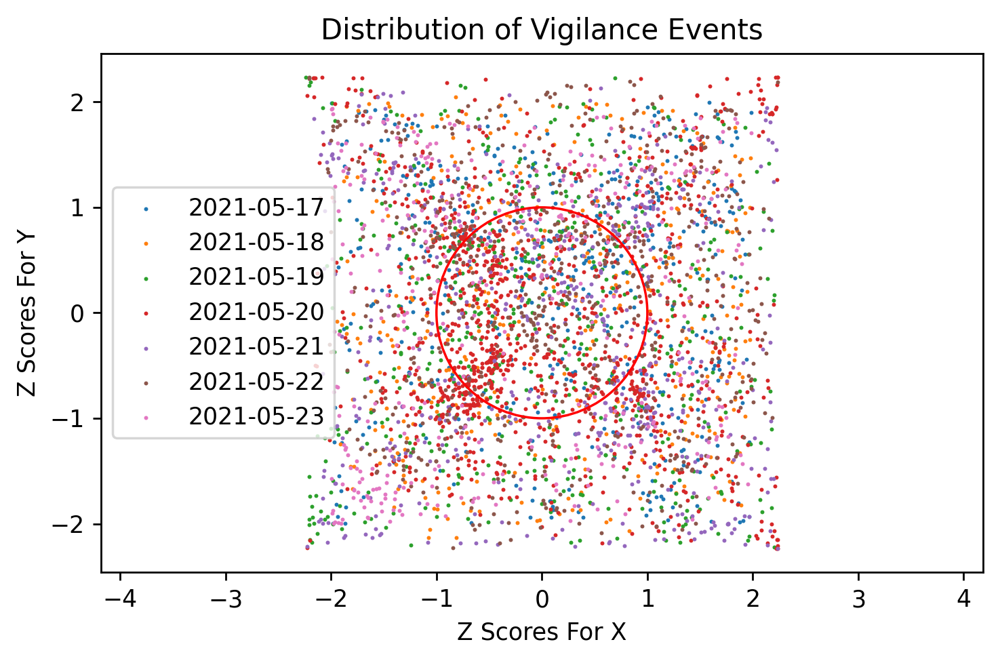

In [11]:
k = 'ZU_2021_1' #ZGroups
J = ['2021-05-17','2021-05-18','2021-05-19','2021-05-20','2021-05-21','2021-05-22','2021-05-23'] #Day
fig,ax= plt.subplots(dpi=250)
ax.set_title('Distribution of Vigilance Events')
ax.set_xlabel('Z Scores For X')
ax.set_ylabel('Z Scores For Y')
vig_events,vig_events_lims = [],[]

complete_corrected_data = pd.DataFrame()
complete_data = pd.DataFrame()
for j in J:
    data = pd.read_csv(ProcessedPath + str(k) + '/GPS_Days/'+ j,index_col=0)
    data = sync_gps_simultaneous(data,k,j)
    complete_data = pd.concat([complete_data,data],axis=0)
    discrete_space_times,centroid_pos = time_discrete(data,20)
    #Centroid Movements, and corresponding heading directions
    centroid_mov =pd.DataFrame()
    centroid_mov['Timestamp'] = discrete_space_times[:-1]
    centroid_mov['Centroid_X'] = [i[0] for i in centroid_pos]
    centroid_mov['Centroid_Y'] = [i[1] for i in centroid_pos]
    dirs = [(centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3]) / np.sqrt(np.sum((centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3])**2))  for i in range(centroid_mov.shape[0]-1) ]
    centroid_mov = centroid_mov.iloc[0:-1,:]
    centroid_mov['Dir_X'] = [i[0] for i in dirs]
    centroid_mov['Dir_Y'] = [i[1] for i in dirs]
    centroid_mov['Distances'] = np.sqrt(centroid_mov['Centroid_X'].diff()**2 + centroid_mov['Centroid_Y'].diff()**2)
    
    data_discrete =  data.set_index('Timestamp').loc[centroid_mov['Timestamp']].reset_index()
    data_discrete = data_discrete.replace([np.inf, -np.inf], np.nan)
    data_discrete = data_discrete.dropna(axis=0).reset_index(drop=True)

    data_discrete = data_discrete.drop(['lat','lon','height-msl'],axis=1)
    corrected_data_discrete = pd.DataFrame()
    for time in data_discrete['Timestamp'].unique():
    
        group_data = data_discrete.loc[data_discrete['Timestamp']==time]
        centroid_data = centroid_mov.loc[centroid_mov['Timestamp']==time]
        new_df =group_data.loc[:,['Timestamp','Behavior','Individual']]
        new_df['Rel_X'] = group_data['X'] - centroid_data['Centroid_X'].values
        new_df['Rel_Y'] = group_data['Y'] - centroid_data['Centroid_Y'].values
        new_df['Distances'] = float(centroid_data.loc[:,'Distances'])
        
        direction_angle = np.arctan(( centroid_data['Dir_Y']/ centroid_data['Dir_X']).values)
        Rel_X = new_df['Rel_X']*np.cos(direction_angle) - new_df['Rel_Y']*np.sin(direction_angle)
        Rel_Y = new_df['Rel_X']*np.sin(direction_angle) + new_df['Rel_Y']*np.cos(direction_angle)
        new_df['Rel_X'] = Rel_X
        new_df['Rel_Y'] = Rel_Y
        new_df['X_zscore'] = (new_df['Rel_X'] - np.mean(new_df['Rel_X'])) / np.std(new_df['Rel_X']) 
        new_df['Y_zscore'] = (new_df['Rel_Y'] - np.mean(new_df['Rel_Y'])) / np.std(new_df['Rel_Y']) 
         

        corrected_data_discrete = pd.concat([corrected_data_discrete,new_df],axis=0)
    complete_corrected_data = pd.concat([complete_corrected_data,corrected_data_discrete],axis=0)    

    vig_data = corrected_data_discrete[corrected_data_discrete['Behavior']=='Vigilance']
    forage_data = corrected_data_discrete[corrected_data_discrete['Behavior']=='Foraging']
    vig_events_lims.append(len(vig_data[np.sqrt(vig_data['X_zscore']**2 + vig_data['Y_zscore']**2)<=1]))
    vig_events.append(len(vig_data))
    ax.scatter(vig_data['X_zscore'],vig_data['Y_zscore'],s=0.5,label=j)

    

    
cir = plt.Circle((0, 0), 1, color='r',fill=False)
ax.set_aspect('equal', adjustable='datalim')
ax.add_patch(cir)
plt.legend()
plt.tight_layout()
plt.show()


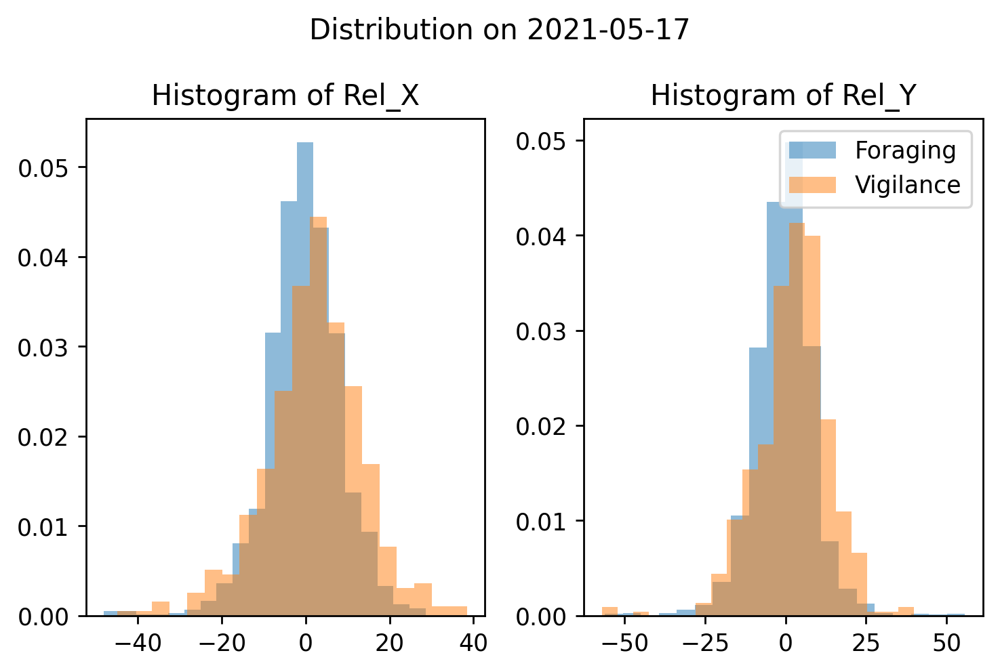

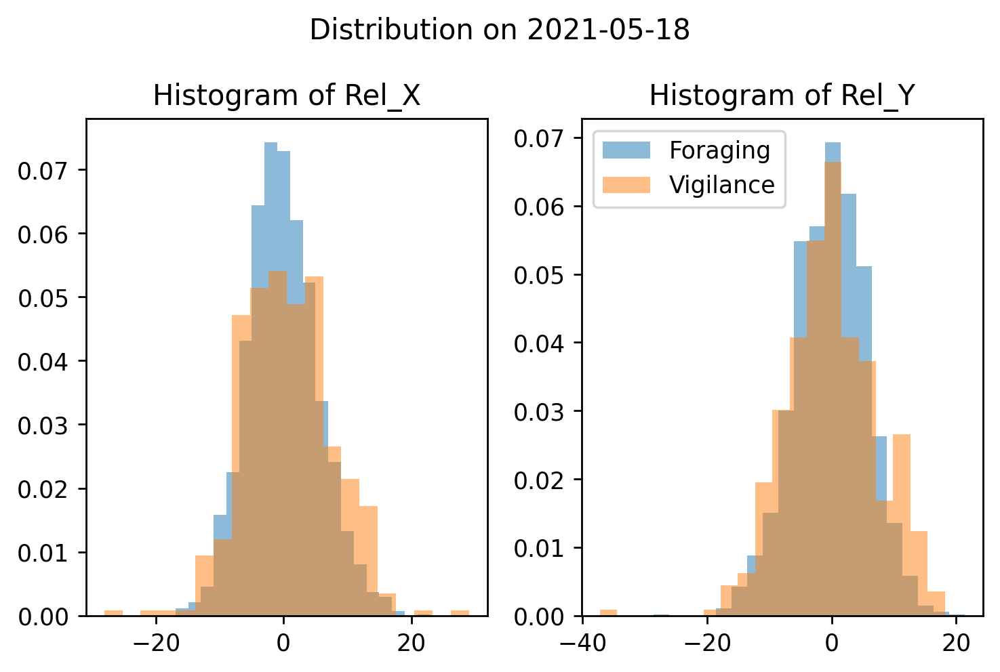

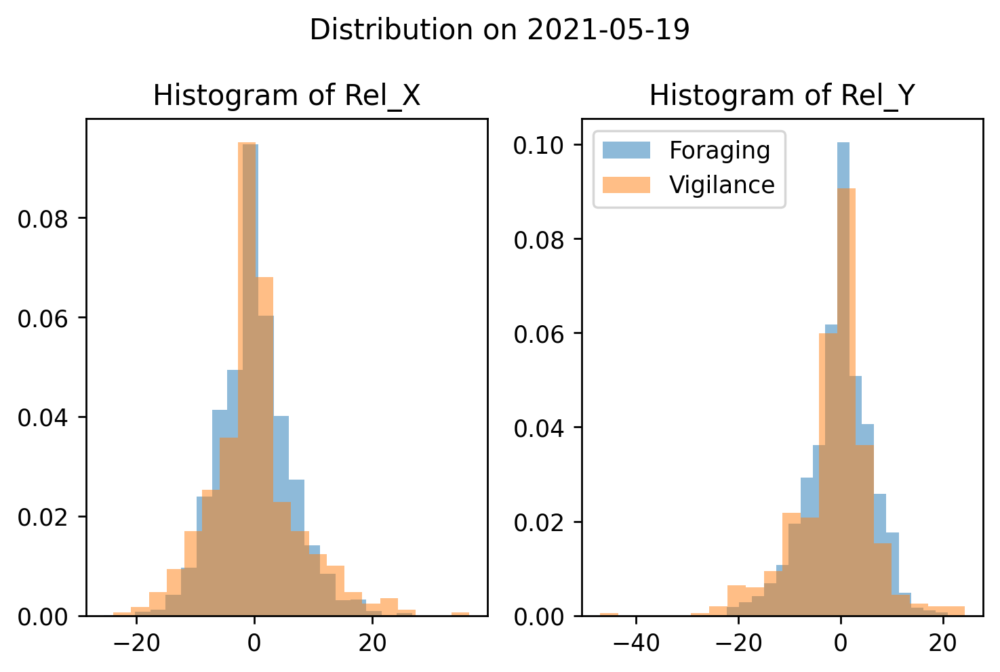

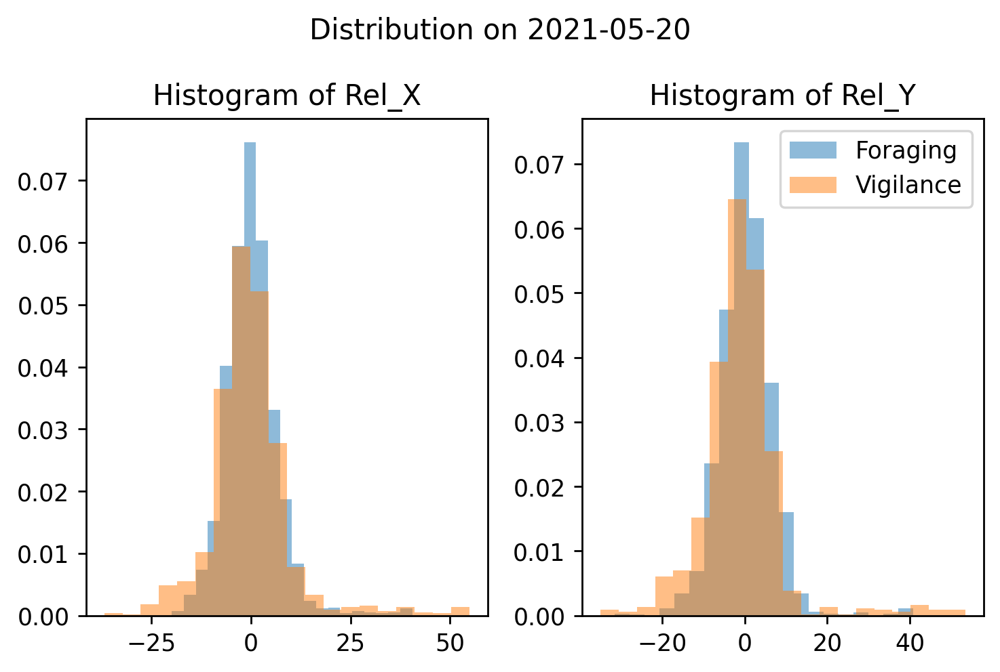

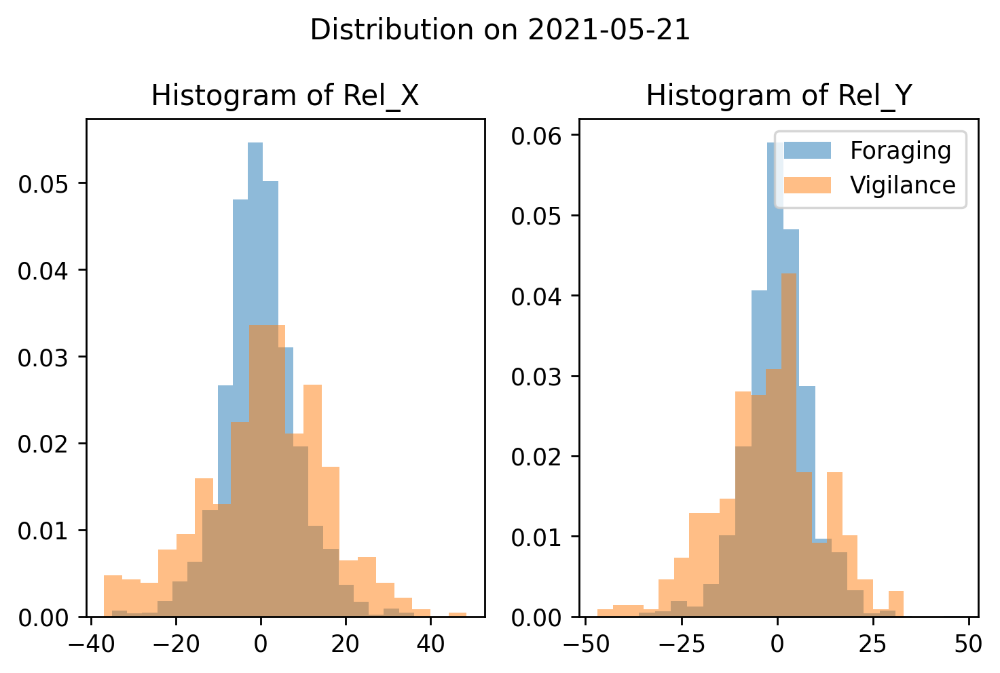

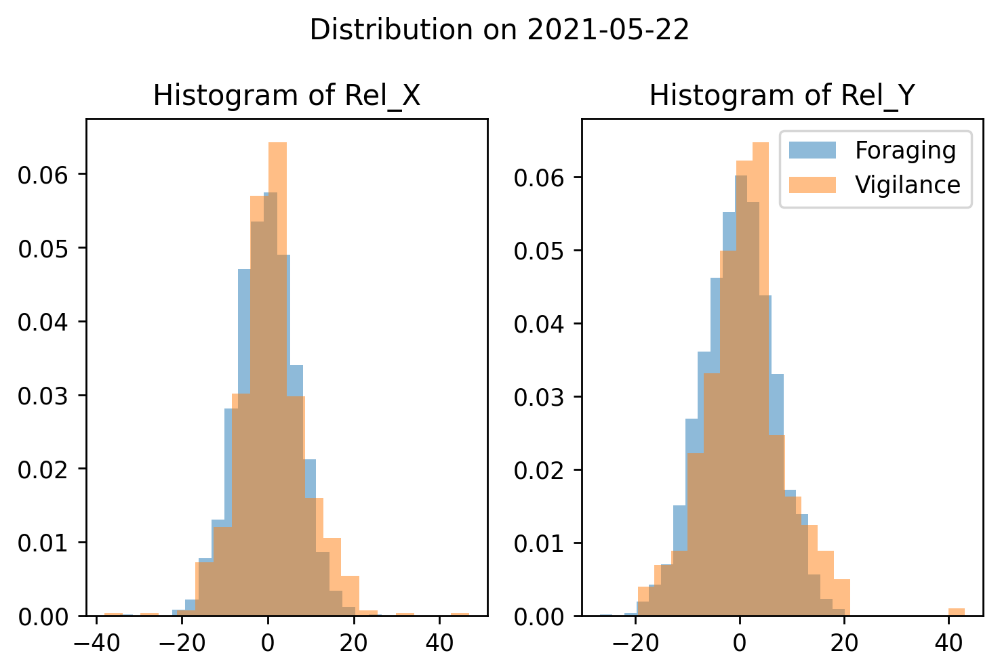

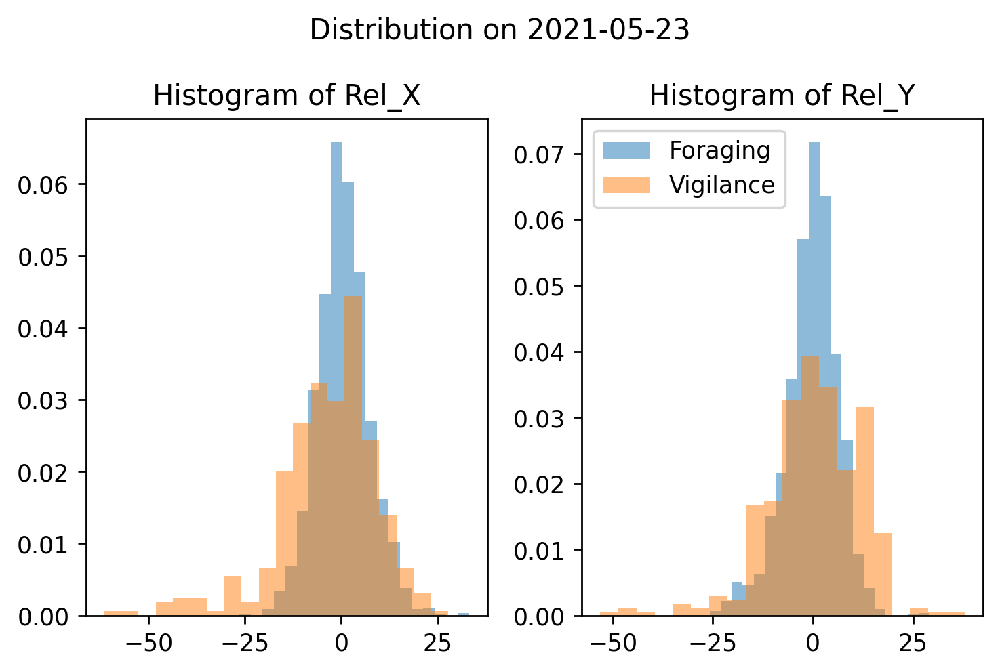

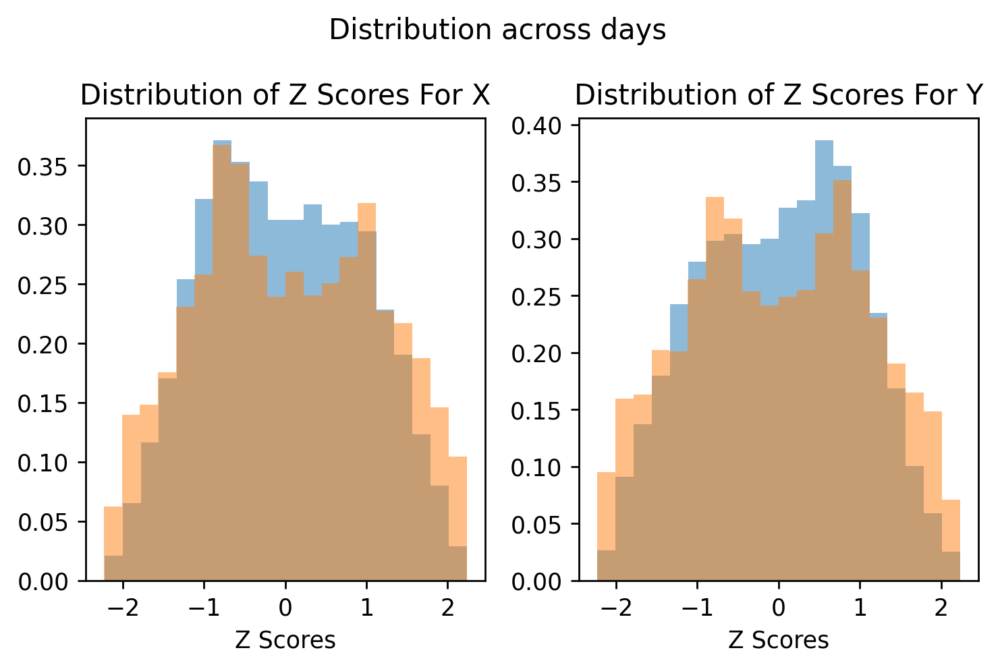

In [12]:
complete_corrected_data['day'] = complete_corrected_data['Timestamp'].dt.date
for i in complete_corrected_data['day'].unique():
    fig,(ax1,ax2) = plt.subplots(nrows=1,ncols=2,dpi=250)
    day_data = complete_corrected_data[complete_corrected_data['day']==i]
    forage_data = day_data.loc[day_data['Behavior']=='Foraging']
    vig_data   = day_data.loc[day_data['Behavior']=='Vigilance']
    feature1,feature2 = 'Rel_X','Rel_Y'
    ax1.hist(forage_data[feature1],alpha=0.5,label="Foraging",density=True,bins=20)
    ax1.hist(vig_data[feature1],alpha=0.5,label="Vigilance",density=True,bins=20)
    ax1.set_title('Histogram of ' + feature1)
    ax2.hist(forage_data[feature2],alpha=0.5,label="Foraging",density=True,bins=20)
    ax2.hist(vig_data[feature2],alpha=0.5,label="Vigilance",density=True,bins=20)
    ax2.set_title('Histogram of ' + feature2)
    plt.legend()
    plt.suptitle('Distribution on ' + str(i))
    plt.tight_layout()
    plt.show()

fig1,(ax1,ax2)= plt.subplots(nrows=1,ncols=2,dpi=250)
ax1.set_title('Distribution of Z Scores For X')
ax1.set_xlabel('Z Scores')
ax1.set_ylabel('')

forage_data = complete_corrected_data.loc[complete_corrected_data['Behavior']=='Foraging',['X_zscore','Y_zscore']]
vig_data   = complete_corrected_data.loc[complete_corrected_data['Behavior']=='Vigilance',['X_zscore','Y_zscore']]
ax1.hist(forage_data['X_zscore'],alpha=0.5,label="Foraging",density=True,bins=20)
ax1.hist(vig_data['X_zscore'],alpha=0.5,label="Vigilance",density=True,bins=20)

ax2.set_title('Distribution of Z Scores For Y')
ax2.set_xlabel('Z Scores')
ax2.set_ylabel('')

ax2.hist(forage_data['Y_zscore'],alpha=0.5,label="Foraging",density=True,bins=20)
ax2.hist(vig_data['Y_zscore'],alpha=0.5,label="Vigilance",density=True,bins=20)
plt.suptitle('Distribution across days')
plt.tight_layout()
plt.show()    



In [ ]:

complete_corrected_data['Theta'] = np.arctan(complete_corrected_data['Rel_Y']/complete_corrected_data['Rel_X'])
complete_corrected_data['R'] = np.sqrt(complete_corrected_data['Rel_Y']**2 + complete_corrected_data['Rel_X']**2)
vig_data = complete_corrected_data.loc[complete_corrected_data['Behavior']=='Vigilance']
forage_data = complete_corrected_data.loc[complete_corrected_data['Behavior']=='Foraging']
complete_corrected_data

,Timestamp,Behavior,Individual,Rel_X,Rel_Y,Distances,X_zscore,Y_zscore,Theta,R
0,2021-05-17 08:09:57,Foraging,VZUF051,-7.545574,8.305457,NaN,-0.880636,0.742380,-0.833301,11.221244
1,2021-05-17 08:09:57,Vigilance,VZUF052,8.898923,8.323331,NaN,1.047061,0.743932,0.751989,12.184772
2,2021-05-17 08:09:57,Vigilance,VZUF054,-1.755439,4.700995,NaN,-0.201891,0.429436,-1.213413,5.018060
3,2021-05-17 08:09:57,Foraging,VZUM056,10.715937,-22.433008,NaN,1.260060,-1.926372,-1.125159,24.861037
4,2021-05-17 08:09:57,Vigilance,VZUM059,-10.479755,-0.122830,NaN,-1.224594,0.010625,0.011720,10.480475
...,...,...,...,...,...,...,...,...,...,...
2555,2021-05-23 10:58:38,Foraging,VZUF051,0.785309,-7.345968,0.816313,0.213436,-0.561354,-1.464297,7.387825
2556,2021-05-23 10:58:38,Foraging,VZUF052,5.775735,7.492779,0.816313,1.345163,0.711405,0.914090,9.460489
2557,2021-05-23 10:58:38,Vigilance,VZUF054,-7.595370,14.009602,0.816313,-1.687131,1.270371,-1.073996,15.936078
2558,2021-05-23 10:58:38,Foraging,VZUM053,-1.552480,-19.365420,0.816313,-0.316727,-1.592295,1.490800,19.427550


<AxesSubplot:>

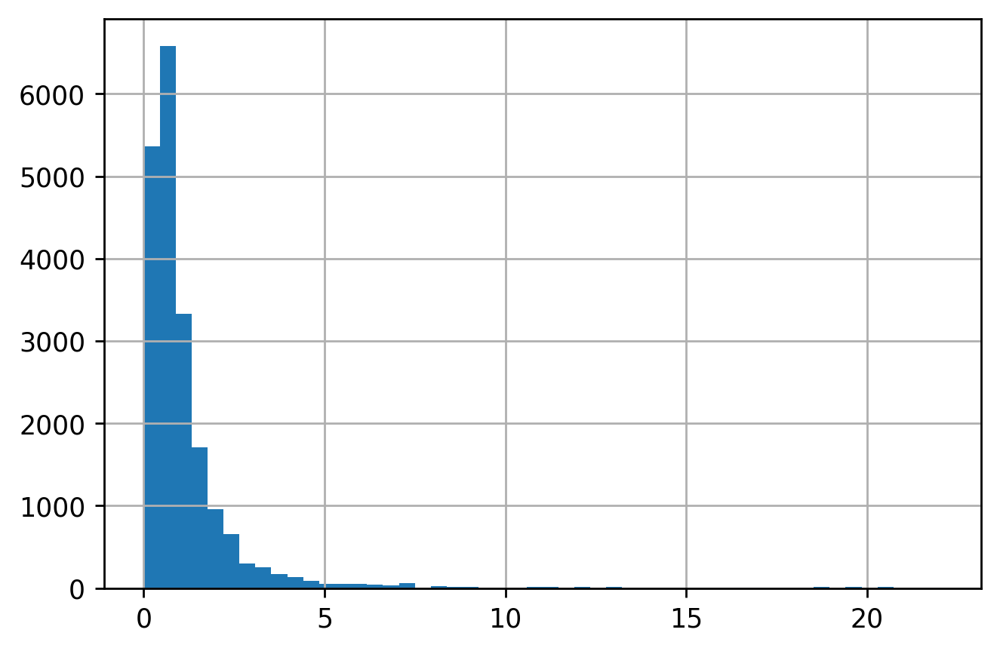

In [ ]:
plt.figure(dpi=250)
complete_corrected_data['Distances'].hist(bins=50)

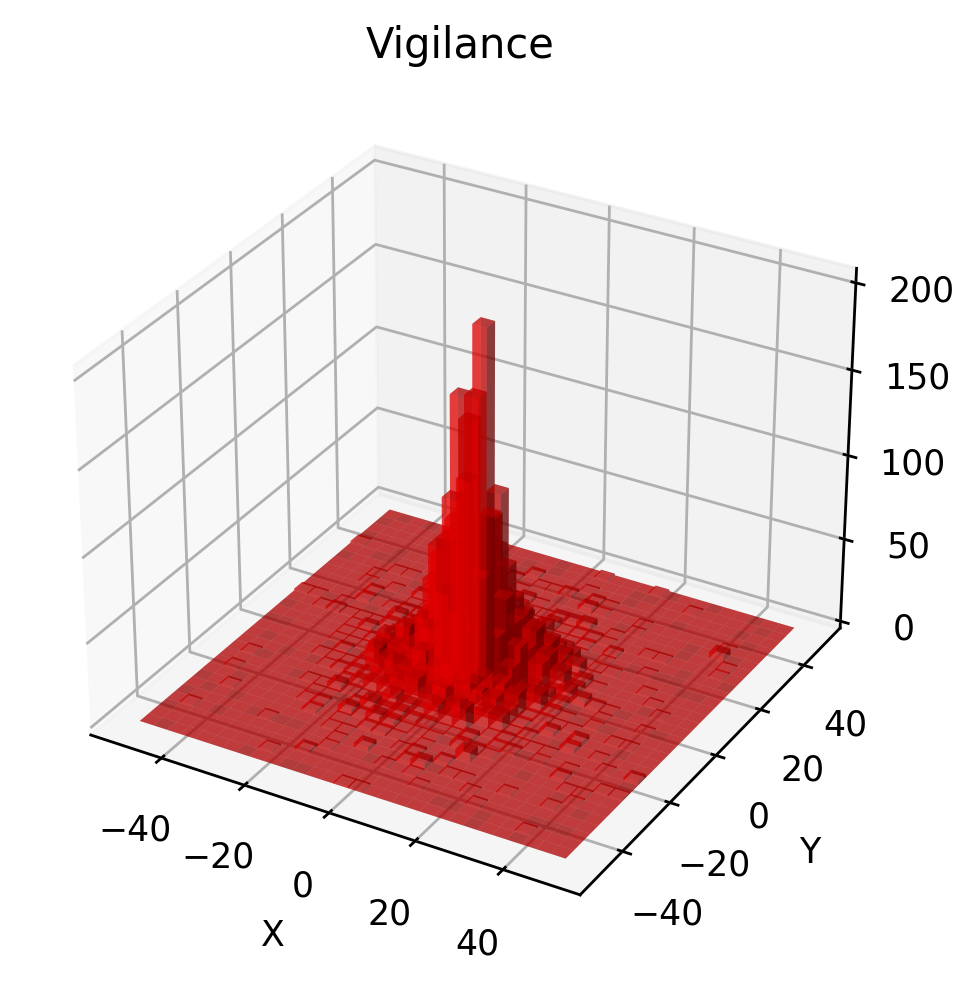

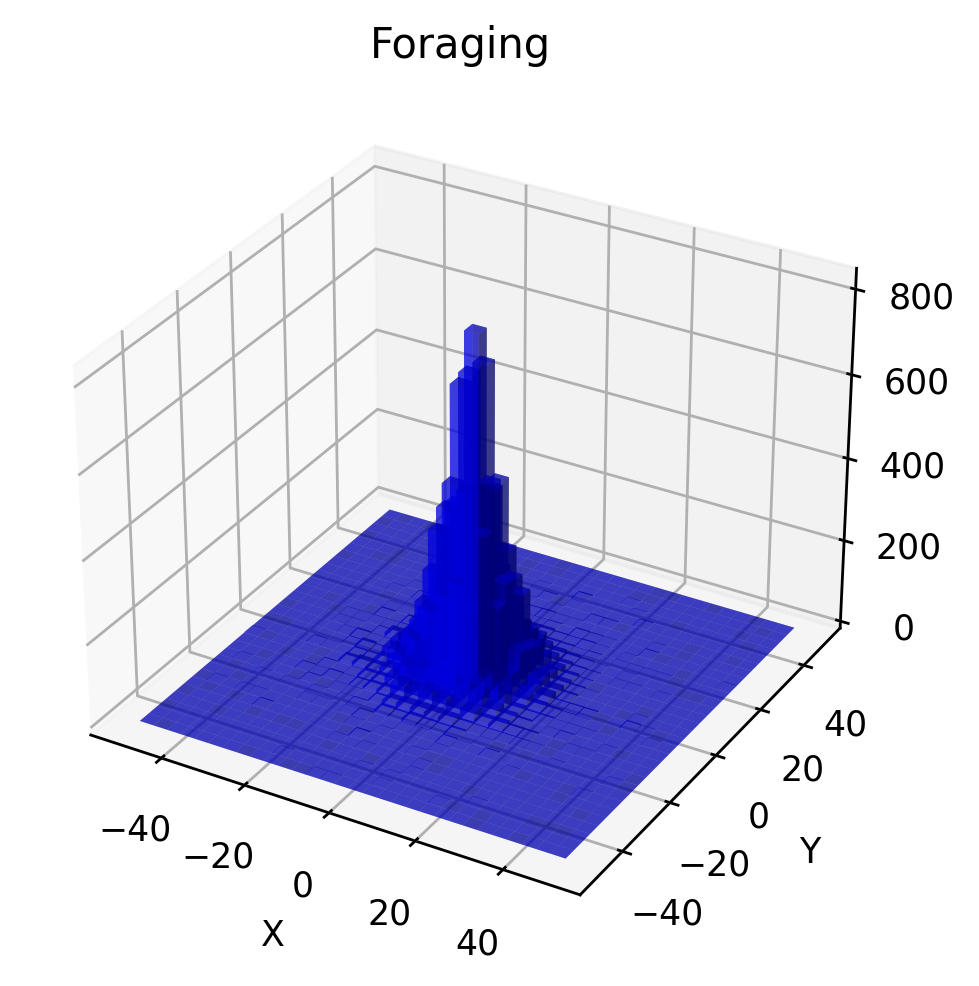

In [ ]:
import numpy as np
import numpy.random
import matplotlib.pyplot as plt
import matplotlib.cm as cm


for i in ['Vigilance','Foraging']:
    
    fig = plt.figure(dpi=250) #create a canvas, tell matplotlib it's 3d
    ax = fig.add_subplot(111, projection='3d')
    
    x = complete_corrected_data.loc[complete_corrected_data['Behavior']==i,'Rel_X']
    y = complete_corrected_data.loc[complete_corrected_data['Behavior']==i,'Rel_Y']

    XY = np.stack((x,y),axis=-1)

    xAmplitudes = np.array(XY)[:,0]
    yAmplitudes = np.array(XY)[:,1]

    
    hist, xedges, yedges = np.histogram2d(x, y, bins=(30,30), range = [[-50,+50],[-50,+50]]) 
    xpos, ypos = np.meshgrid(xedges[:-1]+xedges[1:], yedges[:-1]+yedges[1:]) -(xedges[1]-xedges[0])

    xpos = xpos.flatten()*1./2
    ypos = ypos.flatten()*1./2
    zpos = np.zeros_like (xpos)

    dx = xedges [1] - xedges [0]
    dy = yedges [1] - yedges [0]
    dz = hist.flatten()

    cmap = cm.get_cmap('jet') # Get desired colormap - you can change this!
    max_height = np.max(dz)   # get range of colorbars so we can normalize
    min_height = np.min(dz)
    # scale each z to [0,1], and get their rgb values
    rgba = [cmap((k-min_height)/max_height) for k in dz] 
    if i == 'Foraging':
        colors = 'b'
    else:
        colors = 'r'
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz,color=colors, zsort='average',label=str(i),alpha=0.5)   
    plt.title(i)
    plt.tight_layout()
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.show()


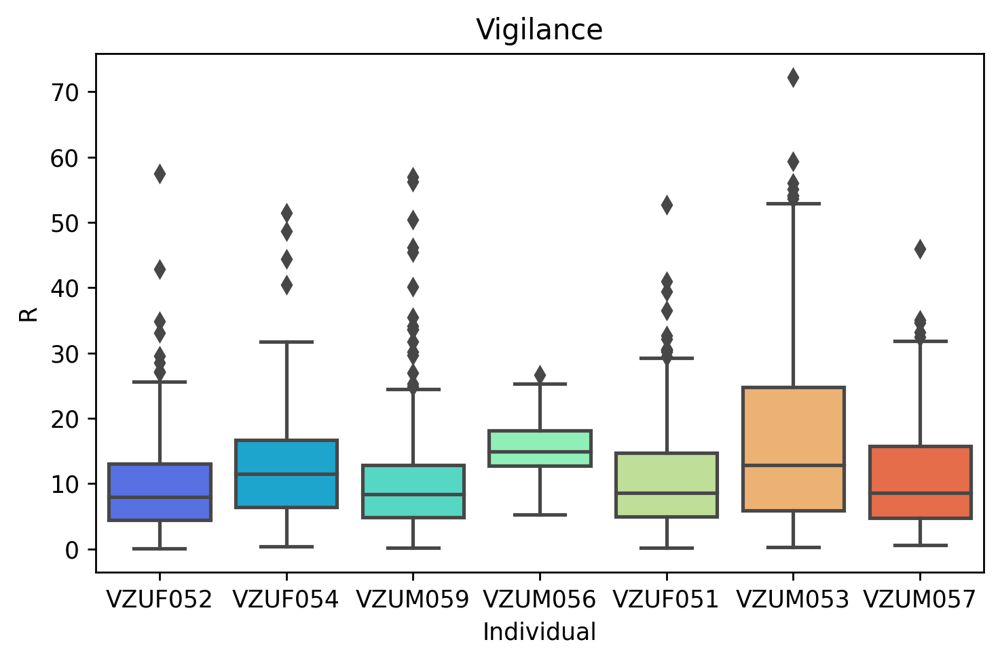

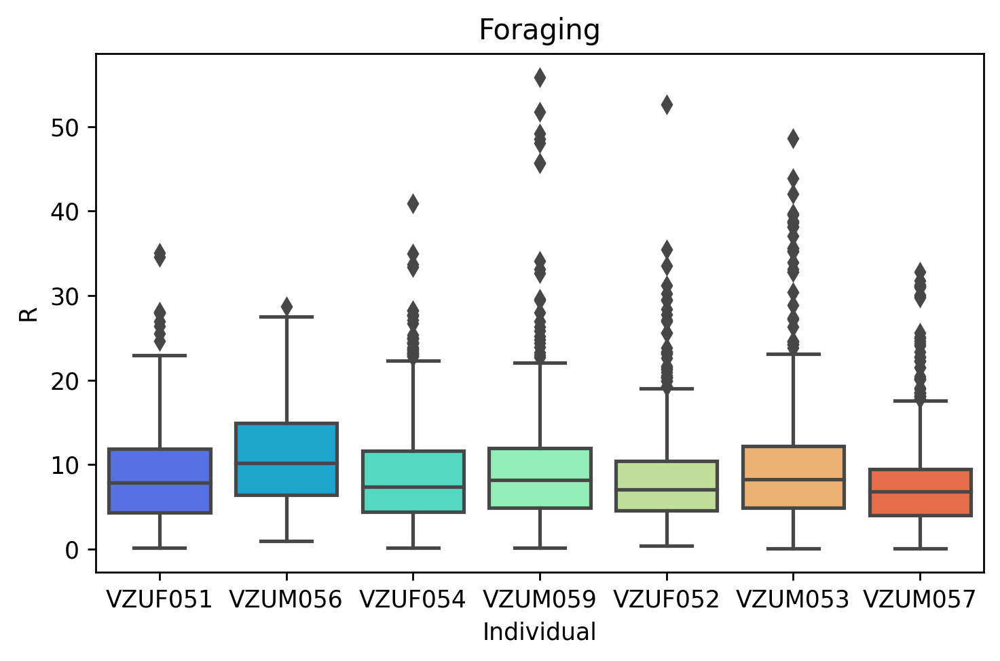

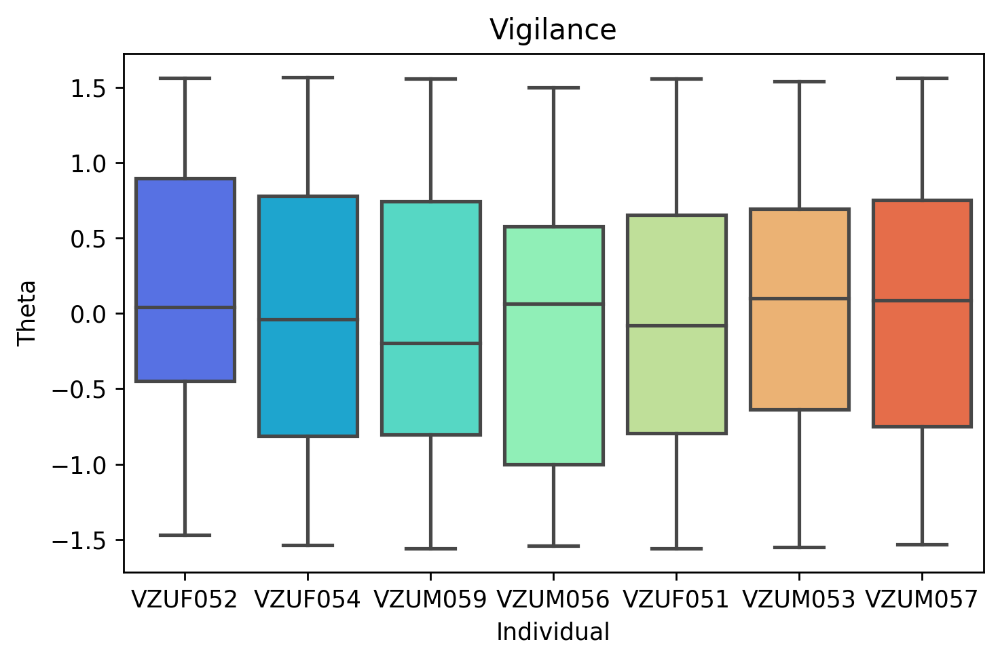

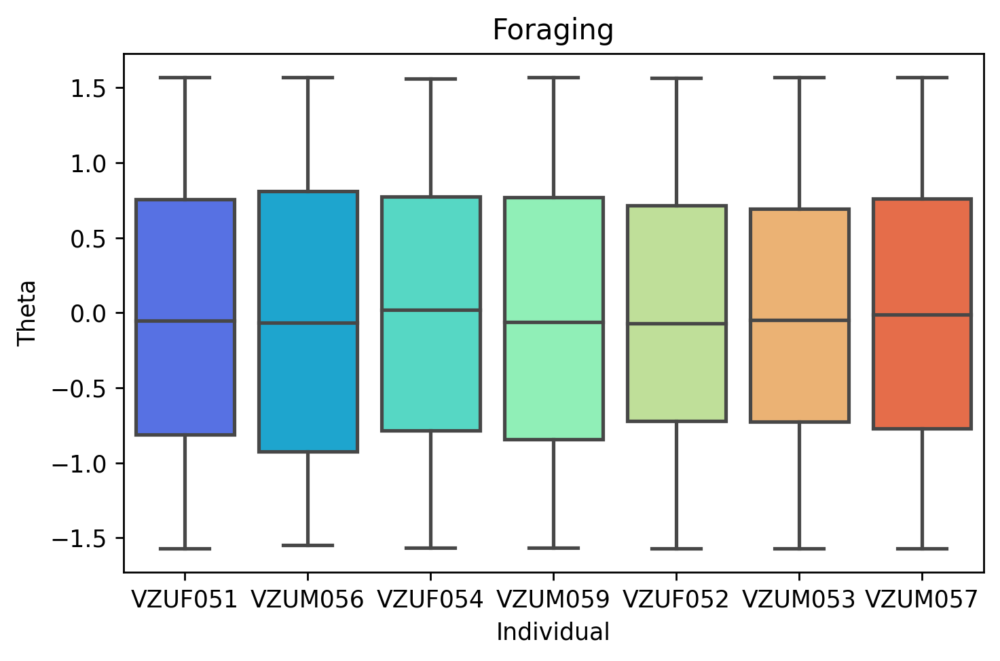

In [ ]:
import seaborn as sns

for i in ['R','Theta']:
    for j in [vig_data,forage_data]:
        fig,ax = plt.subplots(dpi=250)
        sns.boxplot(x='Individual',y=i,data=j[['Individual',i]], palette='rainbow',showfliers=True)
        beh = j.iloc[0,1]
        plt.title(beh)
        plt.tight_layout()
        plt.show()

Bayesian Framework


In [13]:
vig_prior= {}
for i in complete_data['Individual'].unique():
    subset = complete_data.loc[complete_data['Individual']==i,'Behavior']
    vig_prior[i] = np.round(np.sum(subset=='Vigilance') / subset.shape[0],3)
vig_prior

{'VZUF051': 0.246,
 'VZUF052': 0.149,
 'VZUF054': 0.272,
 'VZUM056': 0.113,
 'VZUM059': 0.24,
 'VZUM053': 0.175,
 'VZUM057': 0.197}

,X_zscore,Y_zscore
1,-1.753784,-0.239716
2,-0.139390,-0.408940
4,1.317003,-0.419365
6,0.932021,0.772927
11,-1.001340,0.238510
...,...,...
827,-0.414790,1.616237
832,-1.436727,1.837478
837,-1.841181,-1.659306
842,-1.865463,1.495950


In [32]:
from scipy.stats import gaussian_kde


In [14]:
priors = complete_data.loc[complete_data['Behavior']=='Vigilance'].shape[0]/complete_data.shape[0]
subset = complete_corrected_data[complete_corrected_data['Distances']<10].dropna(axis=0)
subset

,Timestamp,Behavior,Individual,Rel_X,Rel_Y,Distances,X_zscore,Y_zscore,day
5,2021-05-17 08:10:17,Foraging,VZUF051,-7.267267,8.249815,0.935110,-0.836545,0.755348,2021-05-17
6,2021-05-17 08:10:17,Vigilance,VZUF052,9.101616,6.674543,0.935110,1.205558,0.623101,2021-05-17
7,2021-05-17 08:10:17,Foraging,VZUF054,-2.247468,5.012567,0.935110,-0.210299,0.483574,2021-05-17
8,2021-05-17 08:10:17,Foraging,VZUM056,8.269473,-23.966642,0.935110,1.101744,-1.949291,2021-05-17
9,2021-05-17 08:10:17,Foraging,VZUM059,-10.665227,0.291936,0.935110,-1.260458,0.087268,2021-05-17
...,...,...,...,...,...,...,...,...,...
2555,2021-05-23 10:58:38,Foraging,VZUF051,0.785309,-7.345968,0.816313,0.213436,-0.561354,2021-05-23
2556,2021-05-23 10:58:38,Foraging,VZUF052,5.775735,7.492779,0.816313,1.345163,0.711405,2021-05-23
2557,2021-05-23 10:58:38,Vigilance,VZUF054,-7.595370,14.009602,0.816313,-1.687131,1.270371,2021-05-23
2558,2021-05-23 10:58:38,Foraging,VZUM053,-1.552480,-19.365420,0.816313,-0.316727,-1.592295,2021-05-23


In [15]:
subset['Theta'] = np.arctan(subset['Rel_Y']/subset['Rel_X'])
subset['R'] = np.sqrt(subset['Rel_Y']**2 + subset['Rel_X']**2)
subset['day'] = subset['Timestamp'].dt.date
subset

,Timestamp,Behavior,Individual,Rel_X,Rel_Y,Distances,X_zscore,Y_zscore,day,Theta,R
5,2021-05-17 08:10:17,Foraging,VZUF051,-7.267267,8.249815,0.935110,-0.836545,0.755348,2021-05-17,-0.848634,10.994208
6,2021-05-17 08:10:17,Vigilance,VZUF052,9.101616,6.674543,0.935110,1.205558,0.623101,2021-05-17,0.632751,11.286671
7,2021-05-17 08:10:17,Foraging,VZUF054,-2.247468,5.012567,0.935110,-0.210299,0.483574,2021-05-17,-1.149302,5.493355
8,2021-05-17 08:10:17,Foraging,VZUM056,8.269473,-23.966642,0.935110,1.101744,-1.949291,2021-05-17,-1.238546,25.353187
9,2021-05-17 08:10:17,Foraging,VZUM059,-10.665227,0.291936,0.935110,-1.260458,0.087268,2021-05-17,-0.027366,10.669222
...,...,...,...,...,...,...,...,...,...,...,...
2555,2021-05-23 10:58:38,Foraging,VZUF051,0.785309,-7.345968,0.816313,0.213436,-0.561354,2021-05-23,-1.464297,7.387825
2556,2021-05-23 10:58:38,Foraging,VZUF052,5.775735,7.492779,0.816313,1.345163,0.711405,2021-05-23,0.914090,9.460489
2557,2021-05-23 10:58:38,Vigilance,VZUF054,-7.595370,14.009602,0.816313,-1.687131,1.270371,2021-05-23,-1.073996,15.936078
2558,2021-05-23 10:58:38,Foraging,VZUM053,-1.552480,-19.365420,0.816313,-0.316727,-1.592295,2021-05-23,1.490800,19.427550


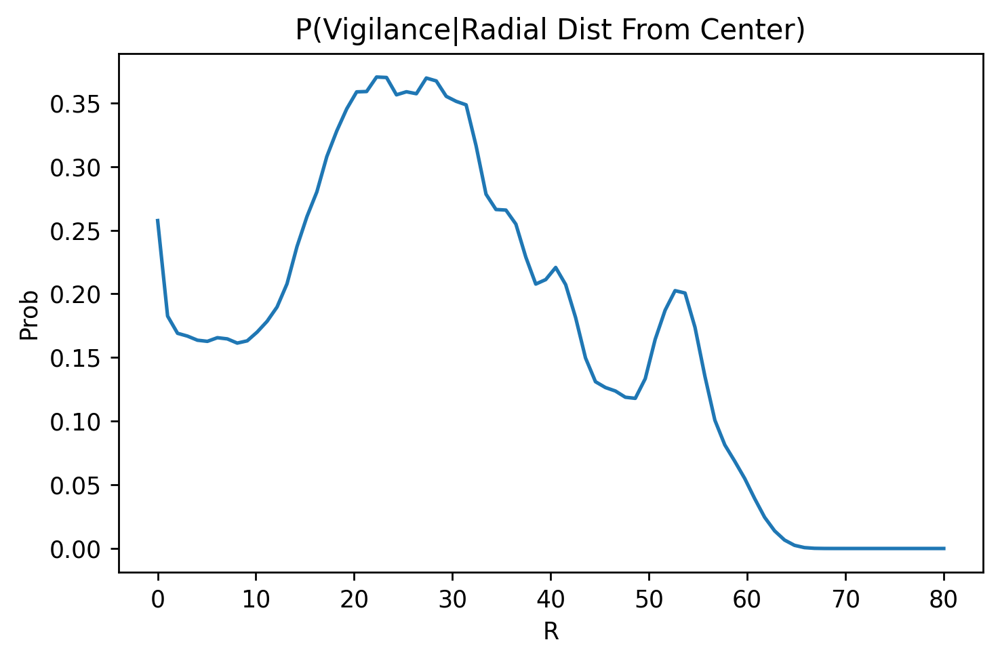

In [20]:
from scipy.stats import gaussian_kde
from matplotlib import cm


#Probability of Position given Vigilance
rx = subset.loc[subset['Behavior']=='Vigilance','R']

R = np.meshgrid(np.linspace(0, 80, 80))

kde = gaussian_kde(rx)

P_vig_pos = kde(R)

R_pos = subset['R']

kde = gaussian_kde(R_pos)

P_group_pos = kde(R)

#P_vig_pos[P_vig_pos<0.0005]=0
for_priors = subset.loc[subset['Behavior']=='Vigilance','R'].shape[0]/subset.shape[0]
P_vig_X = np.divide((P_vig_pos)*for_priors ,P_group_pos+0.001) 
    
fig,axes = plt.subplots(dpi=250)

    

plt.title('P(Vigilance|Radial Dist From Center)')
plt.xlabel('R')
plt.ylabel('Prob')
plt.plot(R[0],P_vig_X)   


plt.tight_layout()
plt.show()

KDE approach Vigilance

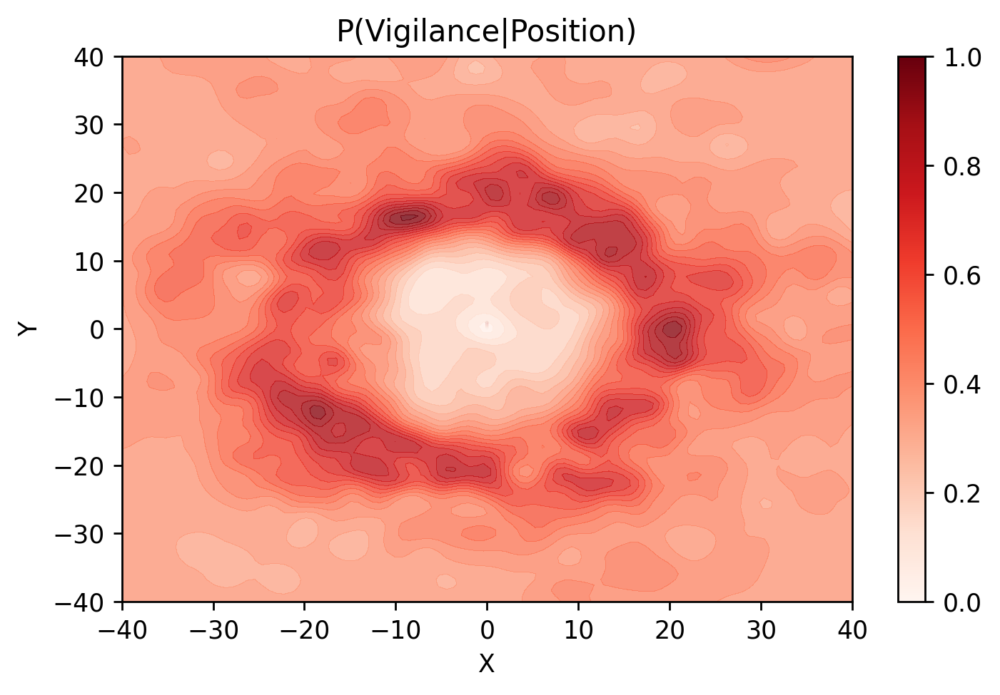

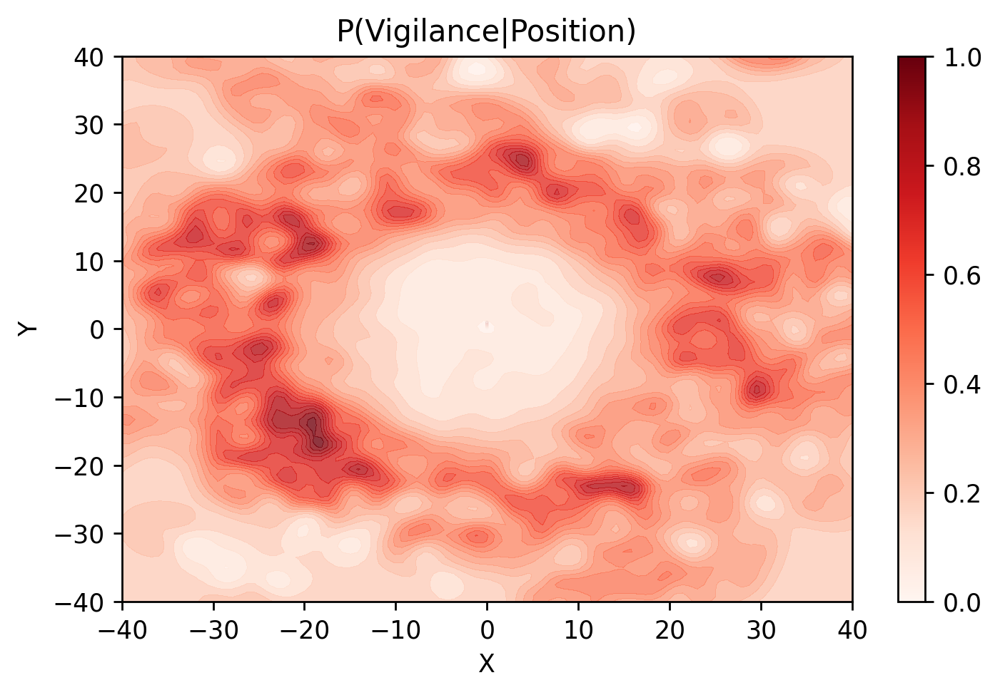

In [44]:
from scipy.stats import gaussian_kde
from matplotlib import cm


#Probability of Position given Vigilance
x = subset.loc[subset['Behavior']=='Vigilance','Rel_X']
y = subset.loc[subset['Behavior']=='Vigilance','Rel_Y']

X, Y = np.meshgrid(np.linspace(-40, 40, 100), np.linspace(-40, 40, 100))

kde = gaussian_kde(np.vstack([x, y]))

P_vig_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

x_pos = subset['Rel_X']
y_pos = subset['Rel_Y']
kde = gaussian_kde(np.vstack([x_pos, y_pos]))

P_group_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
for c in [0.0001,0.00001]:

    P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c) 
    
    fig,axes = plt.subplots(dpi=250)

    axes.contourf(X, Y, P_vig_X,20, alpha=.8,cmap='Reds')

    colors = np.linspace(0,1,20)
    mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Reds')
    plt.title('P(Vigilance|Position)')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.colorbar(mappable)


    plt.tight_layout()
    plt.show()

KDE approach Foraging

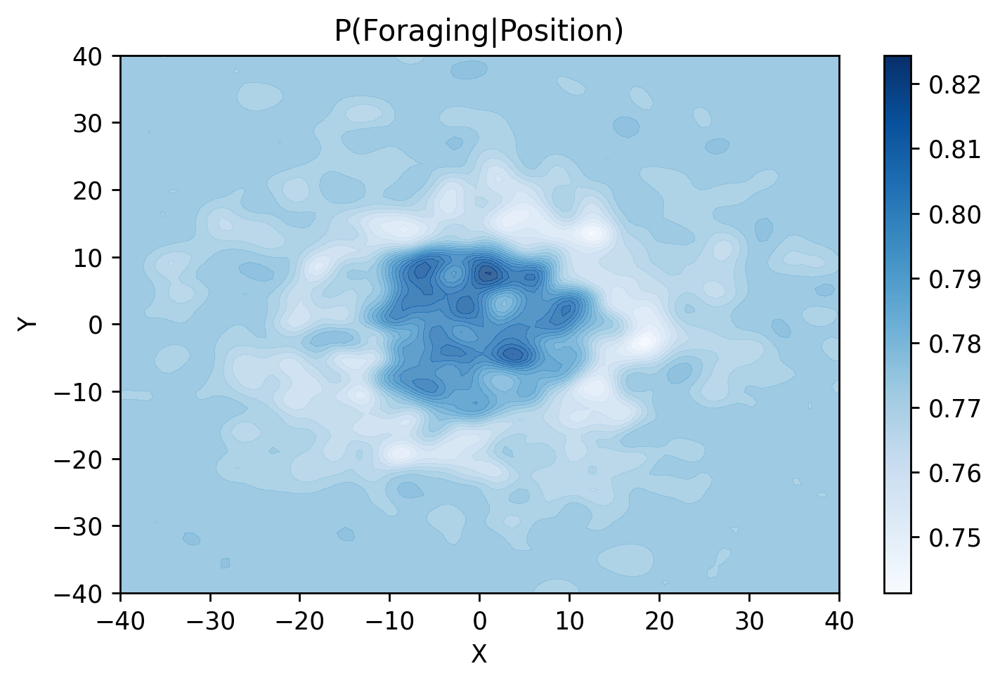

In [ ]:
#Probability of Position given Vigilance
x = subset.loc[subset['Behavior']=='Foraging','Rel_X']
y = subset.loc[subset['Behavior']=='Foraging','Rel_Y']



kde = gaussian_kde(np.vstack([x, y]))

P_for_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

x = subset['Rel_X']
y = subset['Rel_Y']
kde = gaussian_kde(np.vstack([x, y]))

P_group_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
for c in [0.001]:
    priors_for = len(subset.loc[subset['Behavior']=='Foraging','Rel_X']) / len(subset['Rel_X'])
    P_for_X = np.divide((P_for_pos +c)*priors_for ,P_group_pos + c) 
    
    fig,axes = plt.subplots(dpi=250)

    axes.contourf(X, Y, P_for_X,20, alpha=.8,cmap=cm.Blues)

    colors = np.linspace(np.min(P_for_X),np.max(P_for_X),20)
    mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')
    plt.title('P(Foraging|Position)')
    plt.colorbar(mappable)
    plt.xlabel('X')
    plt.ylabel('Y')

    plt.tight_layout()
    plt.show()

In [ ]:
y

23   -18.152571
Name: Rel_Y, dtype: float64

Individual Level Vigilance Distribution KDE

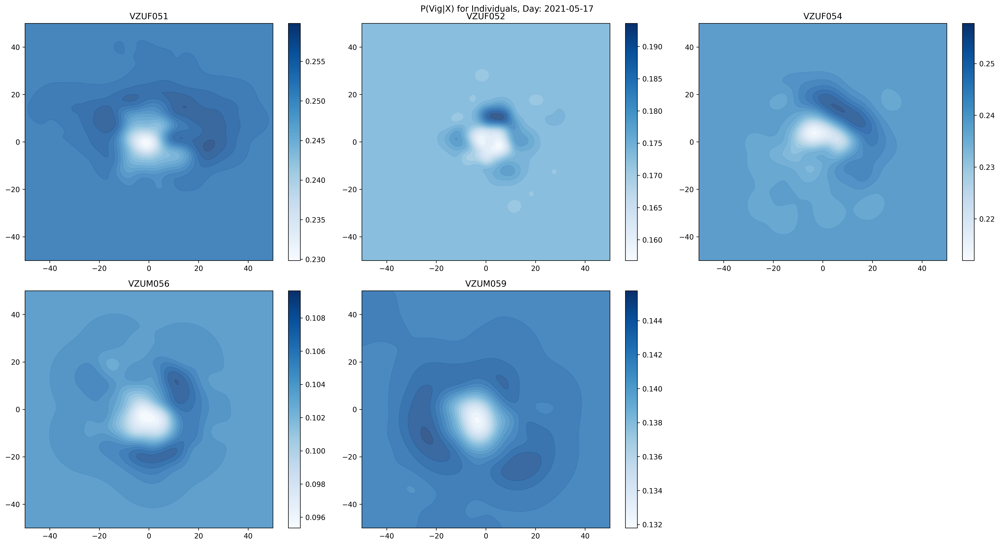

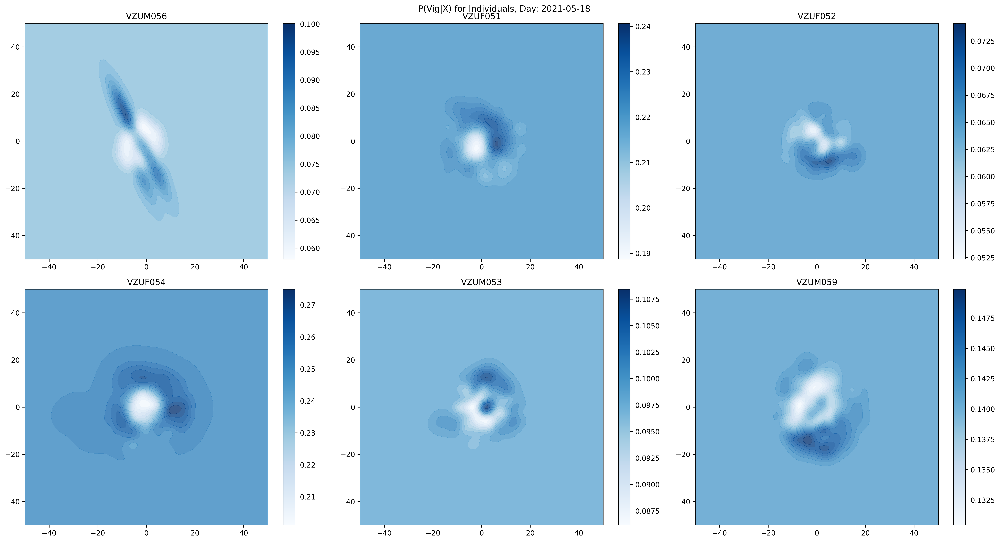

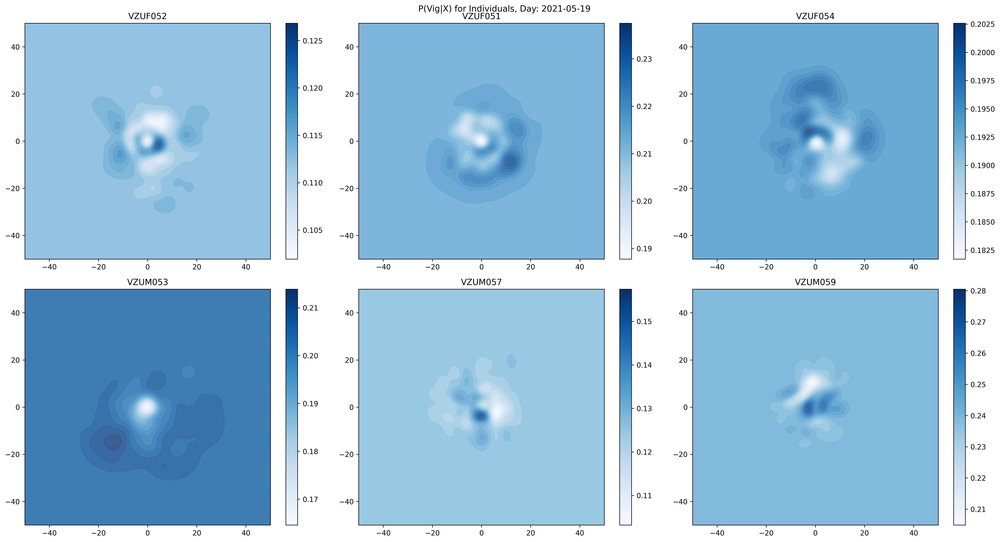

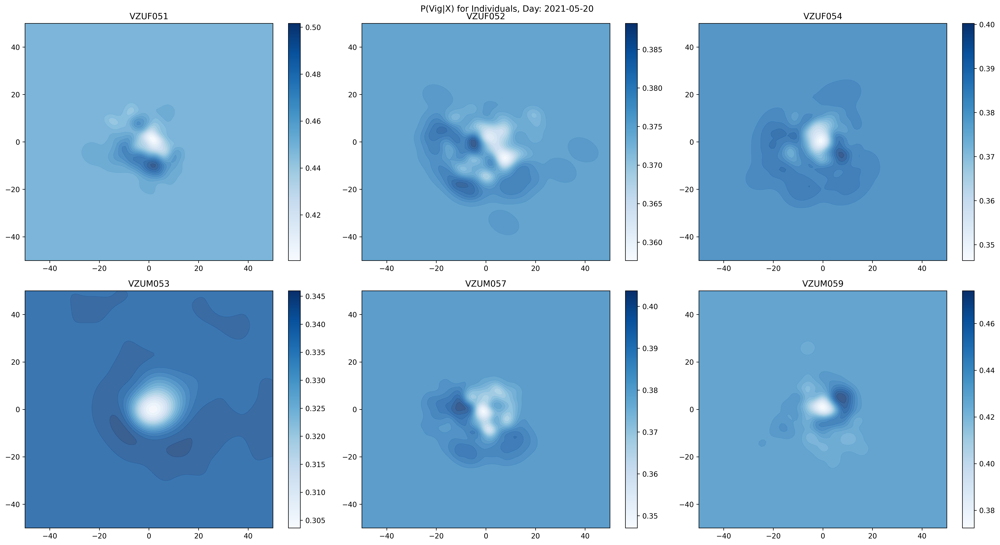

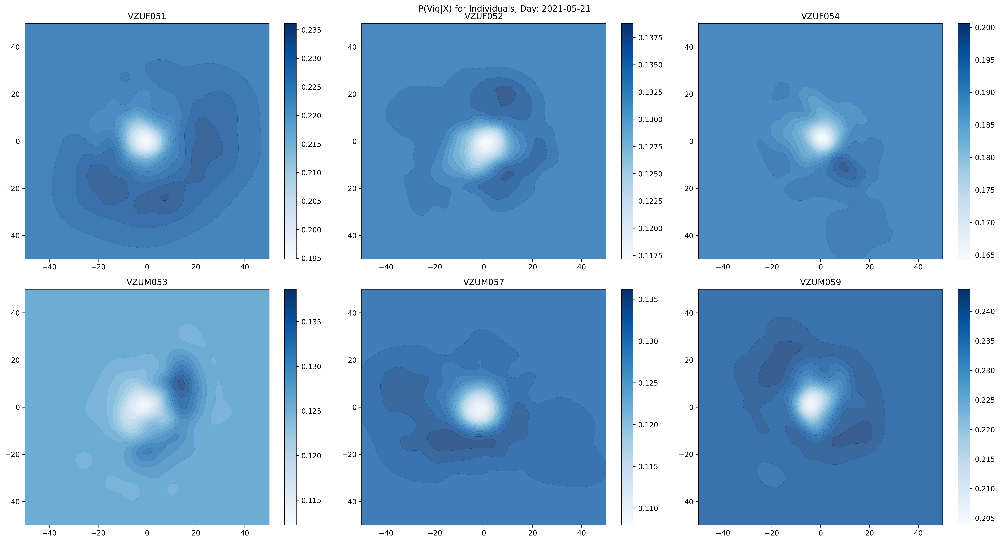

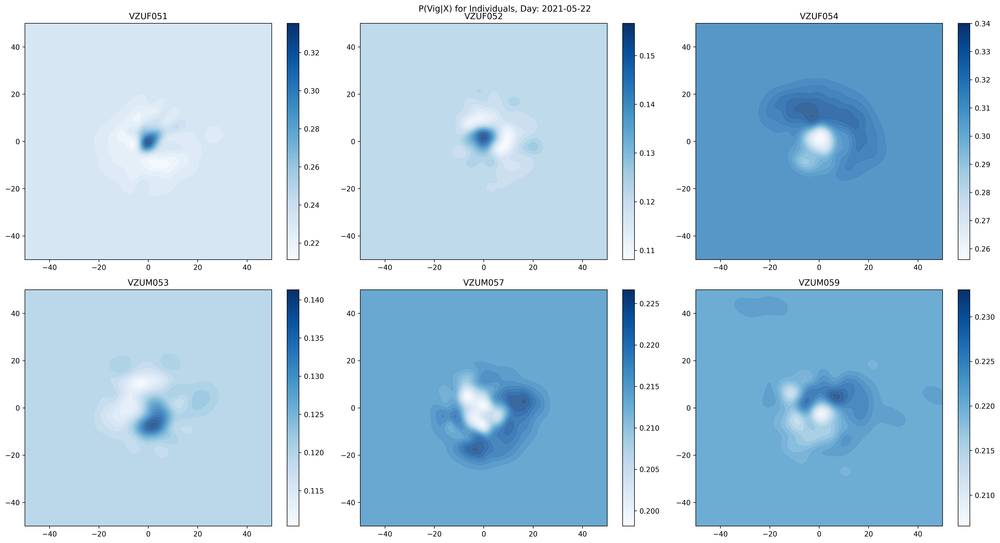

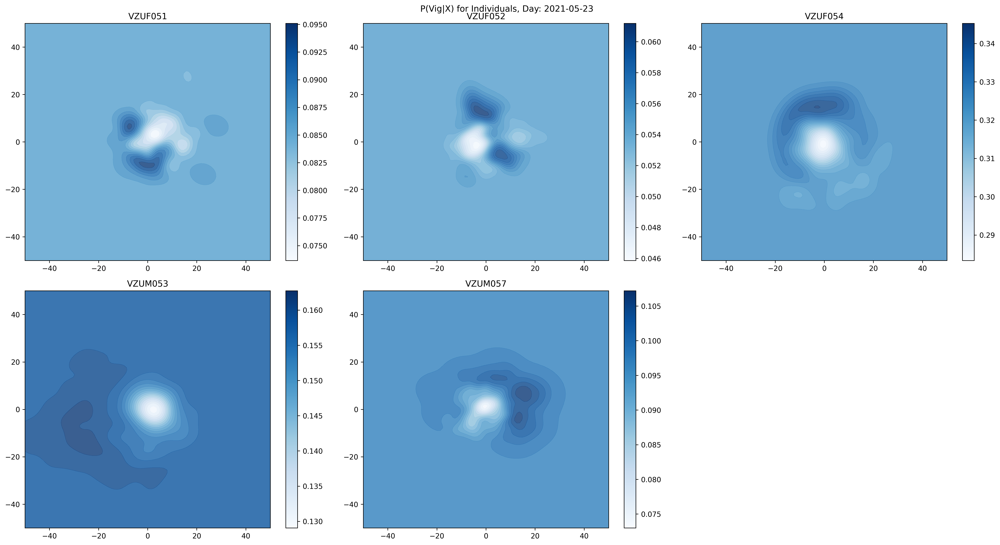

In [ ]:
from matplotlib import cm

for day in subset['day'].unique():
    subsets = subset.loc[subset['day']==day]
    fig,axes = plt.subplots(nrows=3,ncols=3,dpi=350,figsize=(20,16))
    axes = axes.flatten()
    i=0
    for ind in subsets['Individual'].unique():
        val_ind = subsets.loc[subsets['Individual']==ind].dropna(axis=0)
        priors = len(val_ind[val_ind['Behavior']=='Vigilance']) / len(val_ind)
        #P(X|Vig)
        x = val_ind.loc[val_ind['Behavior']=='Vigilance','Rel_X']
        y = val_ind.loc[val_ind['Behavior']=='Vigilance','Rel_Y']
        if len(x) > 3:
            X, Y = np.meshgrid(np.linspace(-50, 50, 100), np.linspace(-50, 50, 100))

            kde = gaussian_kde(np.vstack([x, y]))

            P_vig_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

            #P(X)
            x = val_ind['Rel_X']
            y = val_ind['Rel_Y']
            X, Y = np.meshgrid(np.linspace(-50, 50, 100), np.linspace(-50, 50, 100))

            kde = gaussian_kde(np.vstack([x, y]))

            P_group_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

            #P(Vig|X)
            c=0.01
            P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c) 

            axes[i].contourf(X, Y, P_vig_X,20, alpha=.8,cmap=cm.Blues)
            axes[i].set_title(ind)

            colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
            mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')
            plt.colorbar(mappable, ax=axes[i])


            i = i + 1

        else:
            pass
    for ax in axes[len(subsets['Individual'].unique()):]:
            ax.remove()

    plt.suptitle("P(Vig|X) for Individuals, " + 'Day: ' + str(day))
    plt.tight_layout()

    plt.savefig('Individual Prob Vigilance.png')
    plt.show()

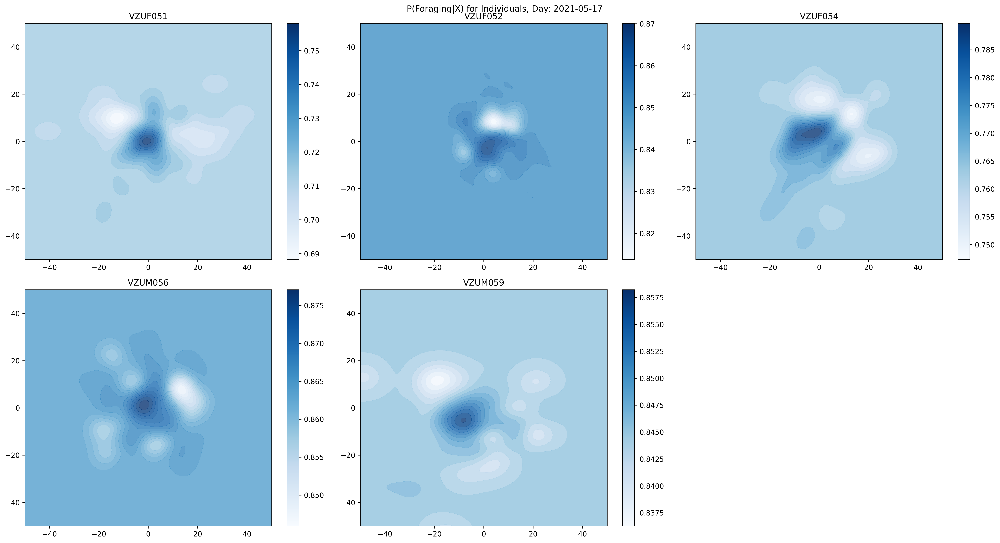

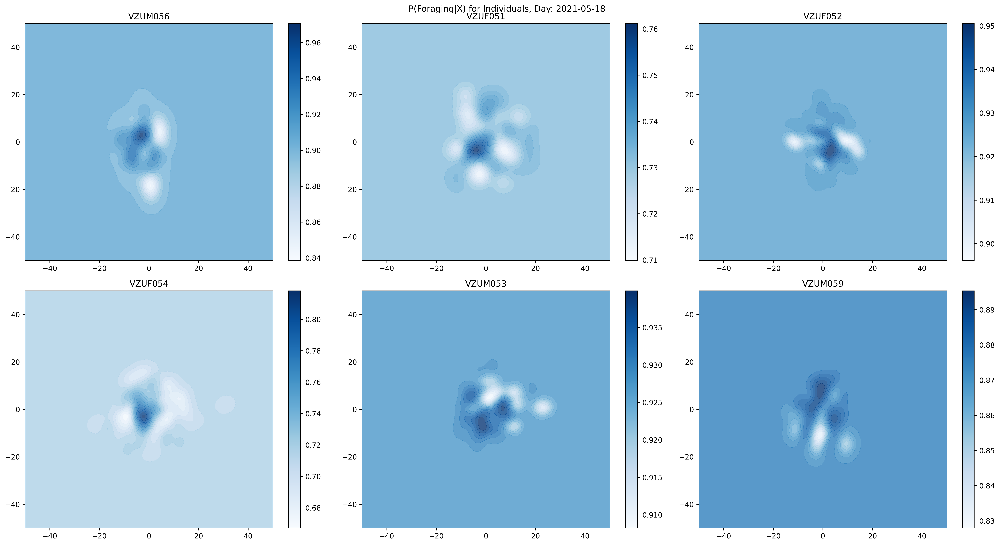

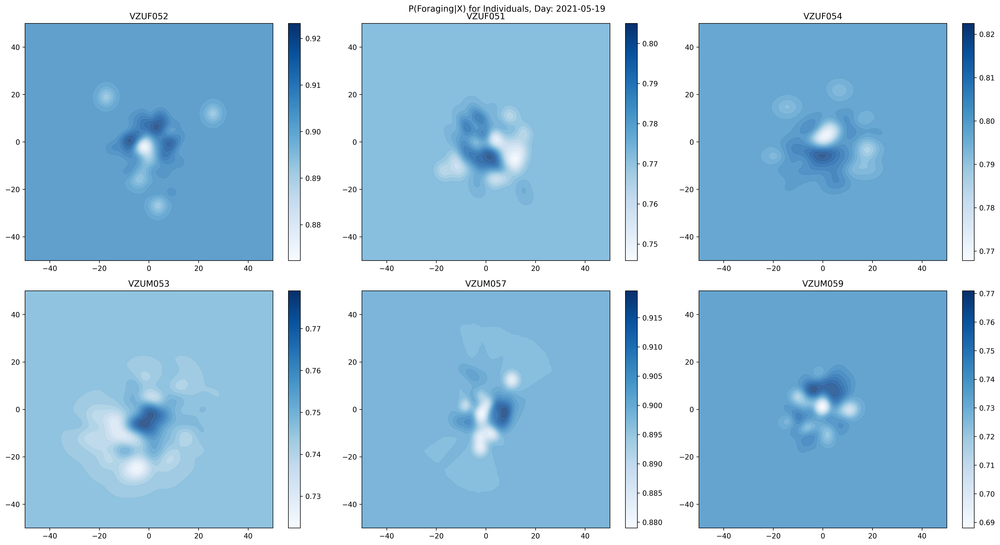

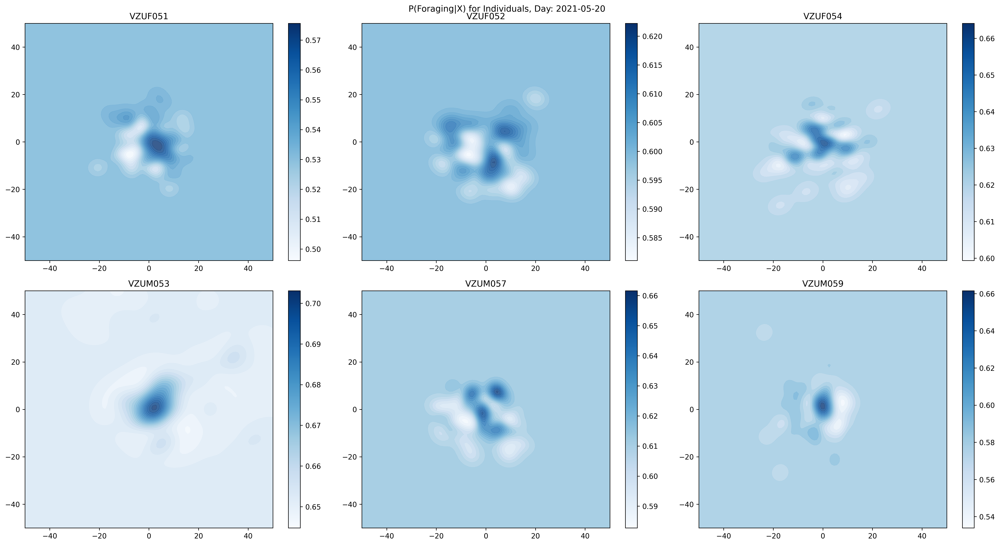

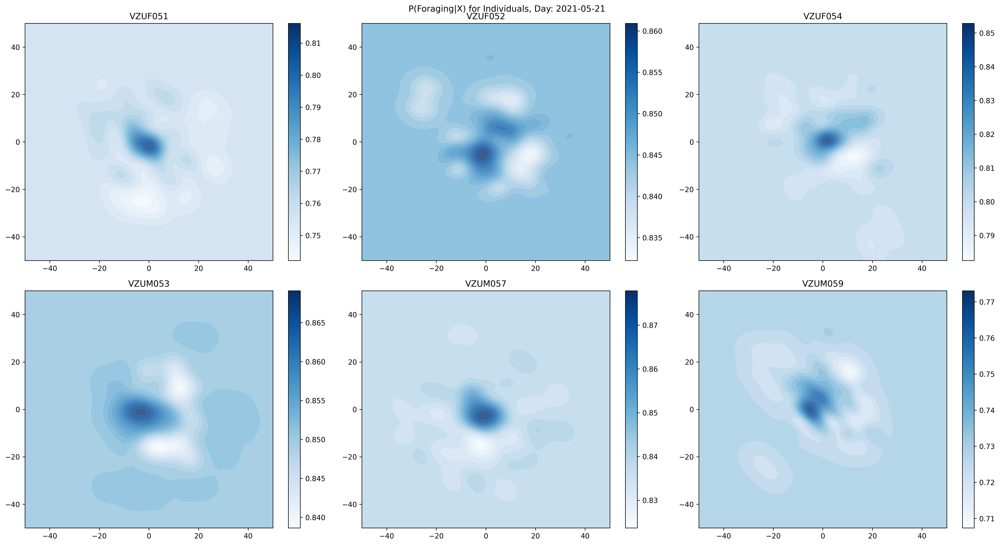

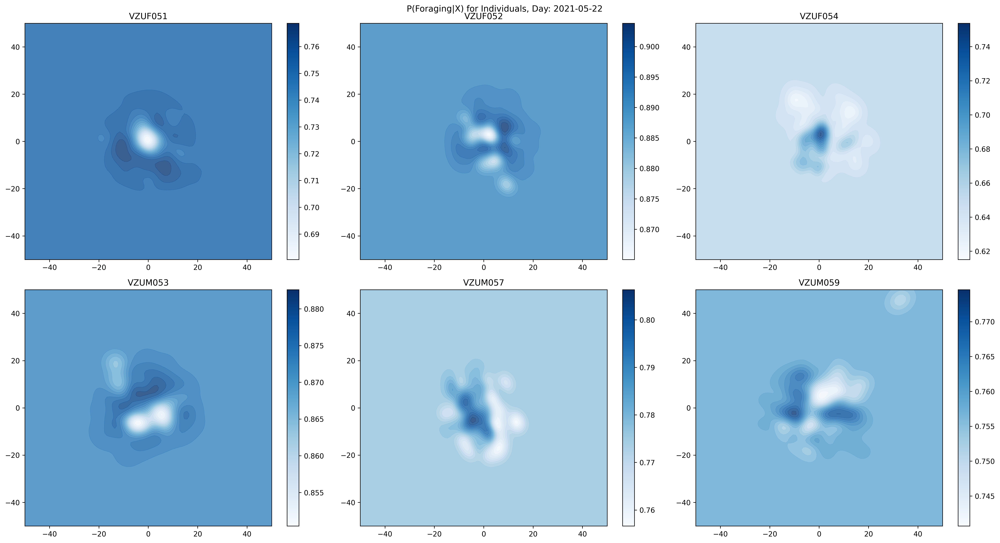

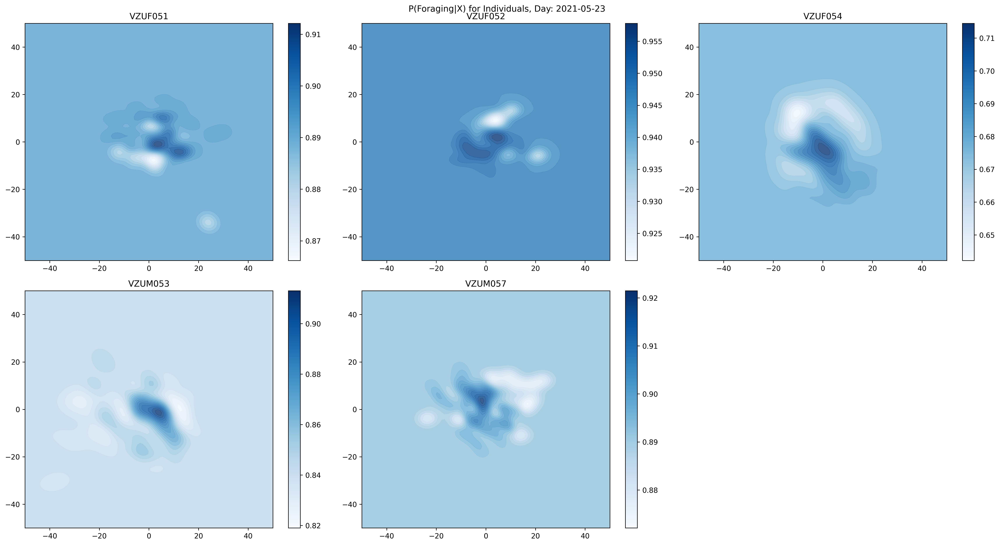

In [ ]:
for day in subset['day'].unique():
    subsets = subset.loc[subset['day']==day]
    fig,axes = plt.subplots(nrows=3,ncols=3,dpi=350,figsize=(20,16))
    axes = axes.flatten()
    i=0
    for ind in subsets['Individual'].unique():
        val_ind = subsets.loc[subsets['Individual']==ind].dropna(axis=0)
        priors = len(val_ind[val_ind['Behavior']=='Foraging']) / len(val_ind)
        #P(X|Vig)
        x = val_ind.loc[val_ind['Behavior']=='Foraging','Rel_X']
        y = val_ind.loc[val_ind['Behavior']=='Foraging','Rel_Y']
        if len(x) > 3:
            X, Y = np.meshgrid(np.linspace(-50, 50, 100), np.linspace(-50, 50, 100))

            kde = gaussian_kde(np.vstack([x, y]))

            P_vig_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

            #P(X)
            x = val_ind['Rel_X']
            y = val_ind['Rel_Y']
            X, Y = np.meshgrid(np.linspace(-50, 50, 100), np.linspace(-50, 50, 100))

            kde = gaussian_kde(np.vstack([x, y]))

            P_group_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

            #P(Vig|X)
            c=0.01
            P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c) 

            axes[i].contourf(X, Y, P_vig_X,20, alpha=.8,cmap=cm.Blues)
            axes[i].set_title(ind)

            colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
            mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')
            plt.colorbar(mappable, ax=axes[i])


            i = i + 1

        else:
            pass
    for ax in axes[len(subsets['Individual'].unique()):]:
            ax.remove()

    plt.suptitle("P(Foraging|X) for Individuals, " + 'Day: ' + str(day))
    plt.tight_layout()

    #plt.savefig('Individual Prob Vigilance.png')
    plt.show()

In [ ]:
vig_prior= {}
for i in complete_data['Individual'].unique():
    sub = complete_data.loc[complete_data['Individual']==i,'Behavior']
    vig_prior[i] = np.round(np.sum(sub=='Vigilance') / sub.shape[0],3)
vig_prior

{'VZUF051': 0.246,
 'VZUF052': 0.149,
 'VZUF054': 0.272,
 'VZUM056': 0.113,
 'VZUM059': 0.24,
 'VZUM053': 0.175,
 'VZUM057': 0.197}

Individual Level Vigilance Distribution Gaussian

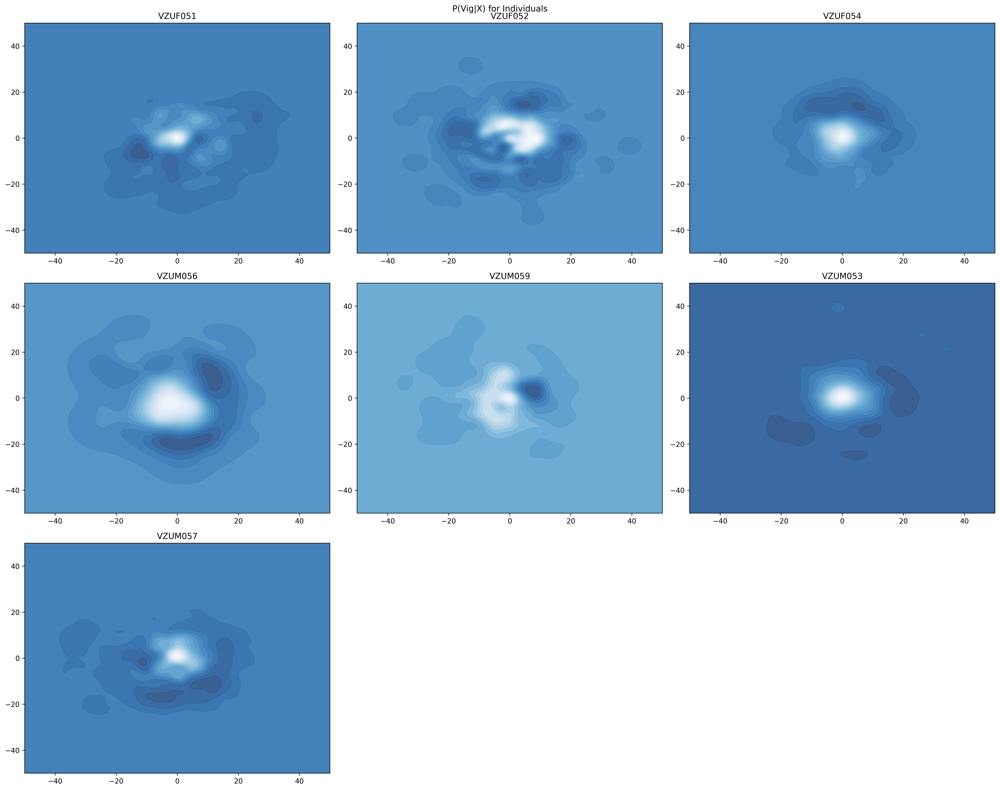

In [ ]:
from matplotlib import cm
fig,axes = plt.subplots(nrows=3,ncols=3,dpi=350,figsize=(20,16))
axes = axes.flatten()
i=0
for ind in subset['Individual'].unique():
    val_ind = subset.loc[subset['Individual']==ind]
    priors = len(val_ind[val_ind['Behavior']=='Vigilance']) / len(val_ind)
    #P(X|Vig)
    x = val_ind.loc[val_ind['Behavior']=='Vigilance','Rel_X']
    y = val_ind.loc[val_ind['Behavior']=='Vigilance','Rel_Y']
    
    X, Y = np.meshgrid(np.linspace(-50, 50, 100), np.linspace(-50, 50, 100))

    kde = gaussian_kde(np.vstack([x, y]))

    P_vig_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
    
    #P(X)
    x = val_ind['Rel_X']
    y = val_ind['Rel_Y']
    

    kde = gaussian_kde(np.vstack([x, y]))

    P_group_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
    
    #P(Vig|X)
    c=0.01
    P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c) 
    
    axes[i].contourf(X, Y, P_vig_X,20, alpha=.8,cmap=cm.Blues)
    axes[i].set_title(ind)
    
    colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
    mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')
    
    
    
    i = i + 1
for ax in axes[len(subset['Individual'].unique()):]:
        ax.remove()
    
plt.suptitle("P(Vig|X) for Individuals")
plt.tight_layout()

plt.savefig('Individual Prob Vigilance.png')
plt.show()

In [ ]:
subset

,Timestamp,Behavior,Individual,Rel_X,Rel_Y,Distances,X_zscore,Y_zscore,Theta,R,day
5,2021-05-17 08:10:17,Foraging,VZUF051,-7.267267,8.249815,0.935110,-0.836545,0.755348,-0.848634,10.994208,2021-05-17
6,2021-05-17 08:10:17,Vigilance,VZUF052,9.101616,6.674543,0.935110,1.205558,0.623101,0.632751,11.286671,2021-05-17
7,2021-05-17 08:10:17,Foraging,VZUF054,-2.247468,5.012567,0.935110,-0.210299,0.483574,-1.149302,5.493355,2021-05-17
8,2021-05-17 08:10:17,Foraging,VZUM056,8.269473,-23.966642,0.935110,1.101744,-1.949291,-1.238546,25.353187,2021-05-17
9,2021-05-17 08:10:17,Foraging,VZUM059,-10.665227,0.291936,0.935110,-1.260458,0.087268,-0.027366,10.669222,2021-05-17
...,...,...,...,...,...,...,...,...,...,...,...
2555,2021-05-23 10:58:38,Foraging,VZUF051,0.785309,-7.345968,0.816313,0.213436,-0.561354,-1.464297,7.387825,2021-05-23
2556,2021-05-23 10:58:38,Foraging,VZUF052,5.775735,7.492779,0.816313,1.345163,0.711405,0.914090,9.460489,2021-05-23
2557,2021-05-23 10:58:38,Vigilance,VZUF054,-7.595370,14.009602,0.816313,-1.687131,1.270371,-1.073996,15.936078,2021-05-23
2558,2021-05-23 10:58:38,Foraging,VZUM053,-1.552480,-19.365420,0.816313,-0.316727,-1.592295,1.490800,19.427550,2021-05-23


Time Duration Sampled across:  0 days 02:48:20


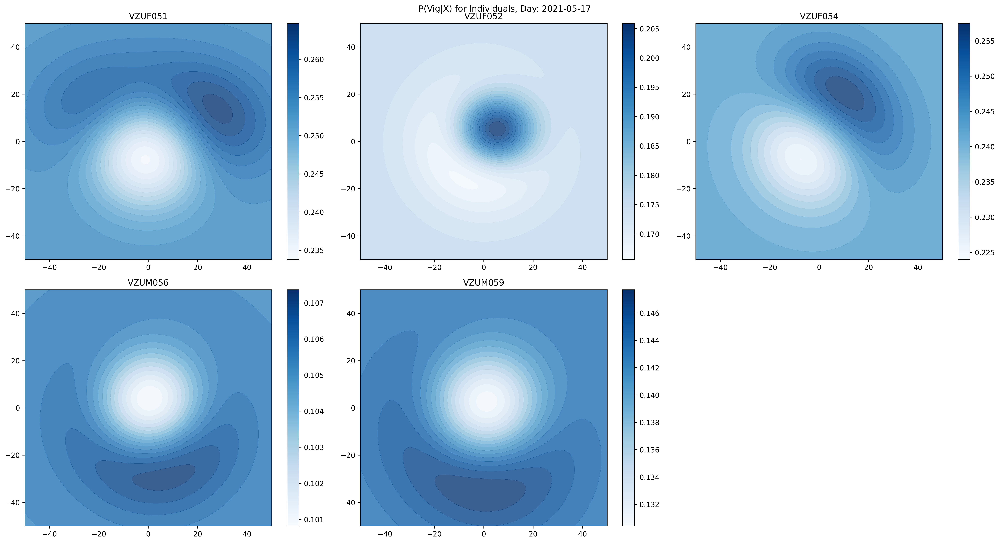

Time Duration Sampled across:  0 days 02:51:40


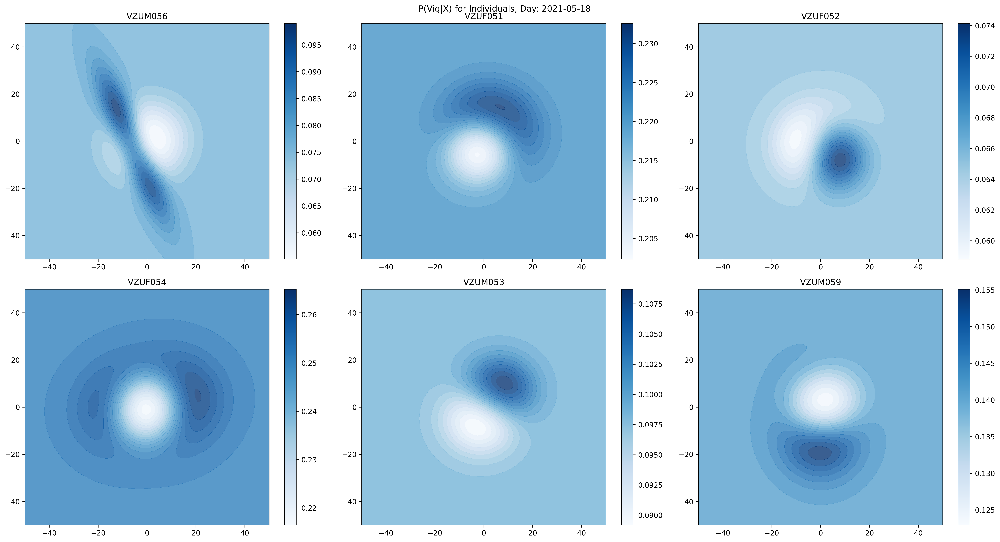

Time Duration Sampled across:  0 days 02:51:20


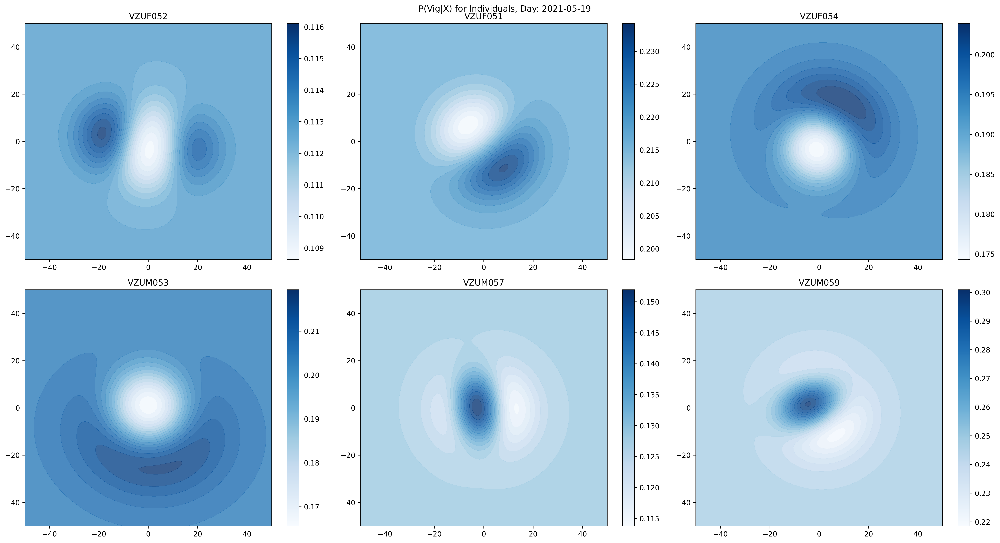

Time Duration Sampled across:  0 days 02:51:00


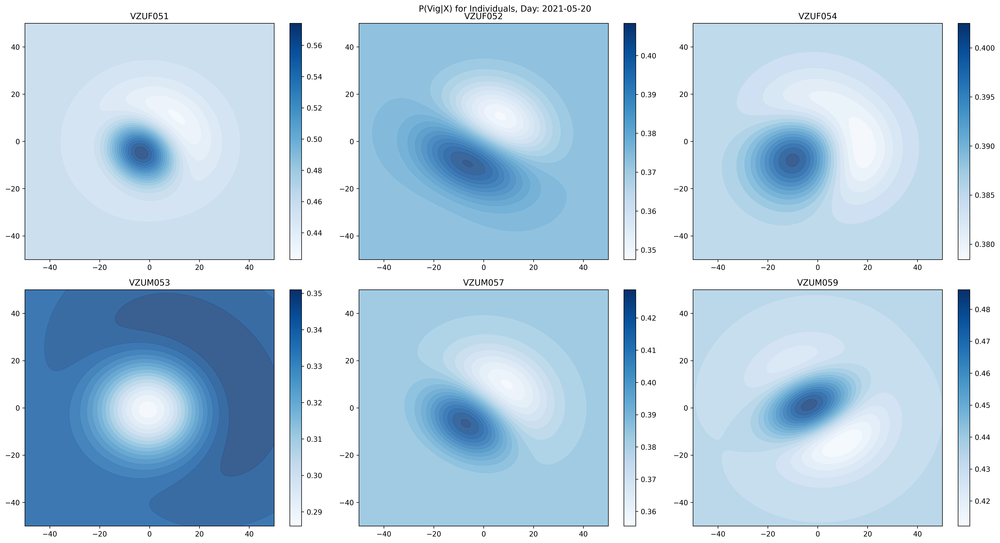

Time Duration Sampled across:  0 days 02:51:20


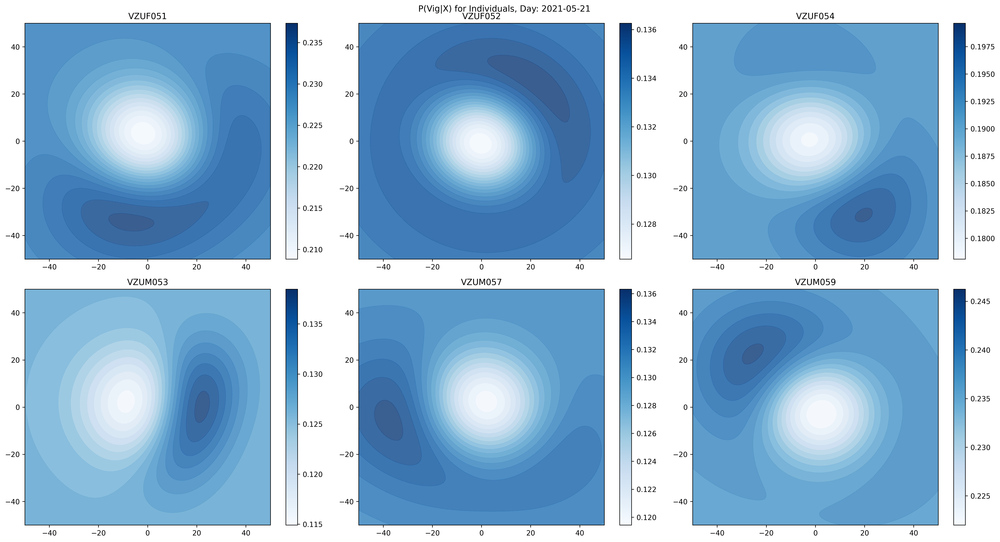

Time Duration Sampled across:  0 days 02:52:00


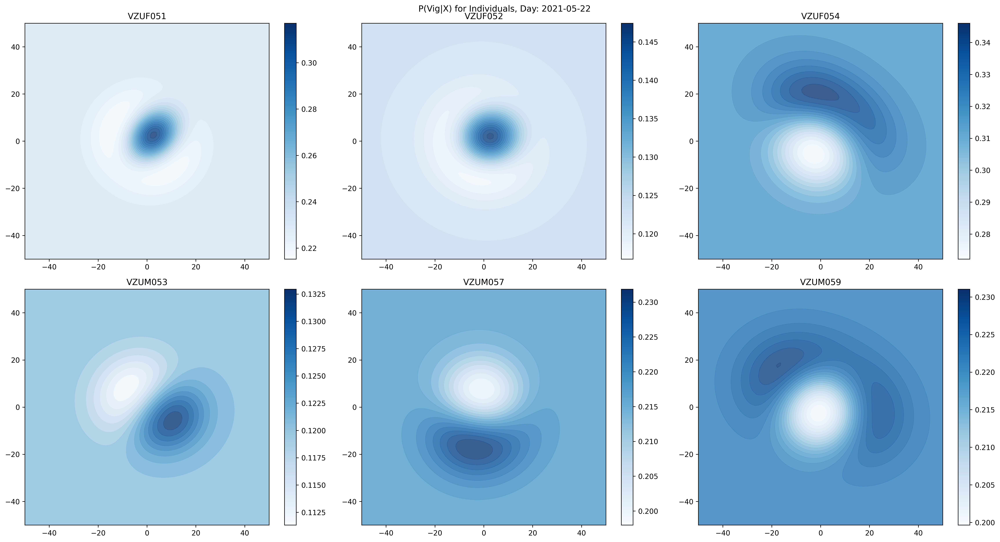

Time Duration Sampled across:  0 days 02:50:00


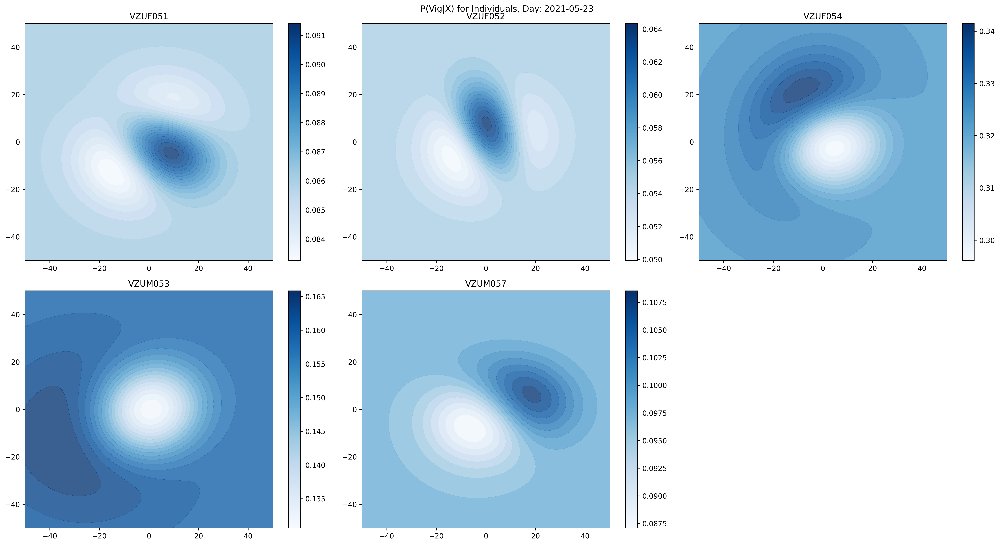

In [ ]:

        
from matplotlib import cm

for date in subset['day'].unique():
    subsets = subset.loc[subset['day']==date].reset_index(drop=True)
    print('Time Duration Sampled across: ', subsets.iloc[-1,0] -subsets.iloc[0,0] )
    fig,axes = plt.subplots(nrows=3,ncols=3,dpi=350,figsize=(20,16))
    axes = axes.flatten()
    i=0
    for ind in subsets['Individual'].unique():
        val_ind = subsets.loc[subsets['Individual']==ind].dropna(axis=0)
        priors = len(val_ind[val_ind['Behavior']=='Vigilance']) / len(val_ind)
        #P(X|Vig)
        x = val_ind.loc[val_ind['Behavior']=='Vigilance','Rel_X']
        y = val_ind.loc[val_ind['Behavior']=='Vigilance','Rel_Y']
        if len(x) > 3:
            X, Y = np.meshgrid(np.linspace(-50, 50, 100), np.linspace(-50, 50, 100))

            d = np.vstack([x,y]).T
            mean = np.mean(d,axis=0)
            cov = np.cov(d, rowvar=0)
            rv = multivariate_normal(mean,cov)
            P_vig_pos = rv.pdf(pos)


            #Probability of Position 

            x = subsets['Rel_X']
            y = subsets['Rel_Y']
            d = np.vstack([x,y]).T
            mean = np.mean(d,axis=0)
            cov = np.cov(d, rowvar=0)
            rv = multivariate_normal(mean,cov)
            P_group_pos = rv.pdf(pos)

            #P(Vig|X)
            c=0.01
            P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c) 
            
            
            axes[i].contourf(X, Y, P_vig_X,20, alpha=.8,cmap=cm.Blues)
            axes[i].set_title(ind)

            colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
            mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')
            plt.colorbar(mappable, ax=axes[i])


            i = i + 1
            
        else:
            pass
    for ax in axes[len(subsets['Individual'].unique()):]:
            ax.remove()

    plt.suptitle("P(Vig|X) for Individuals, " + 'Day: ' + str(date))
    plt.tight_layout()

    
    plt.show()

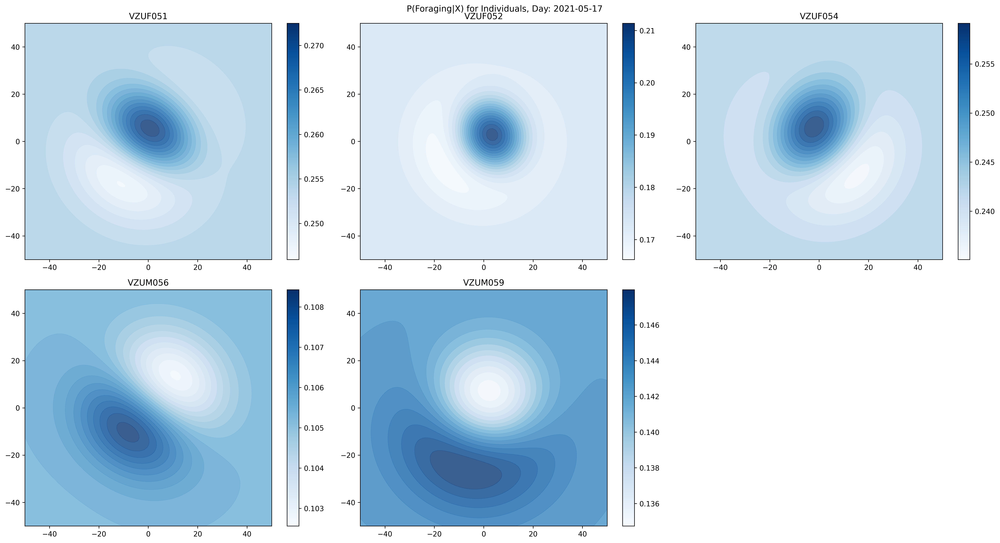

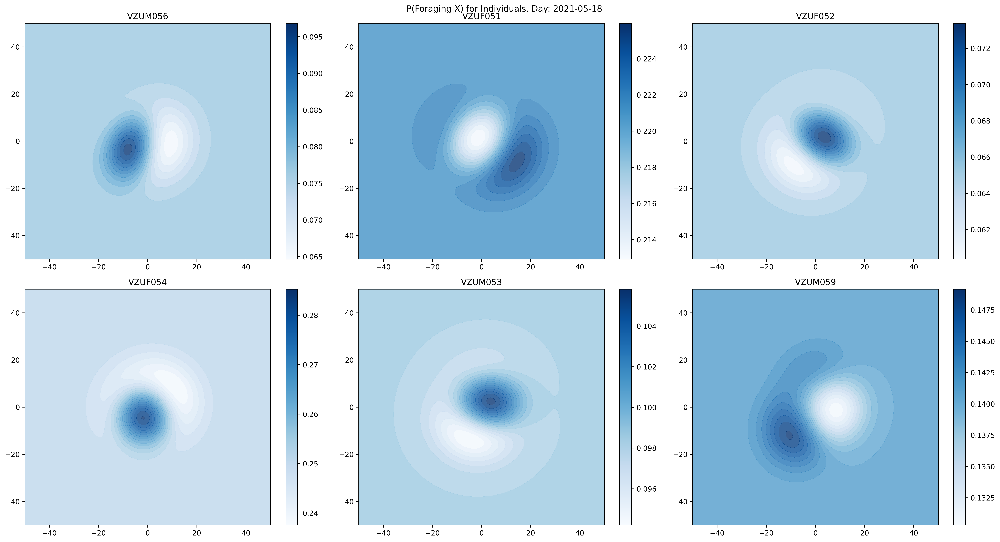

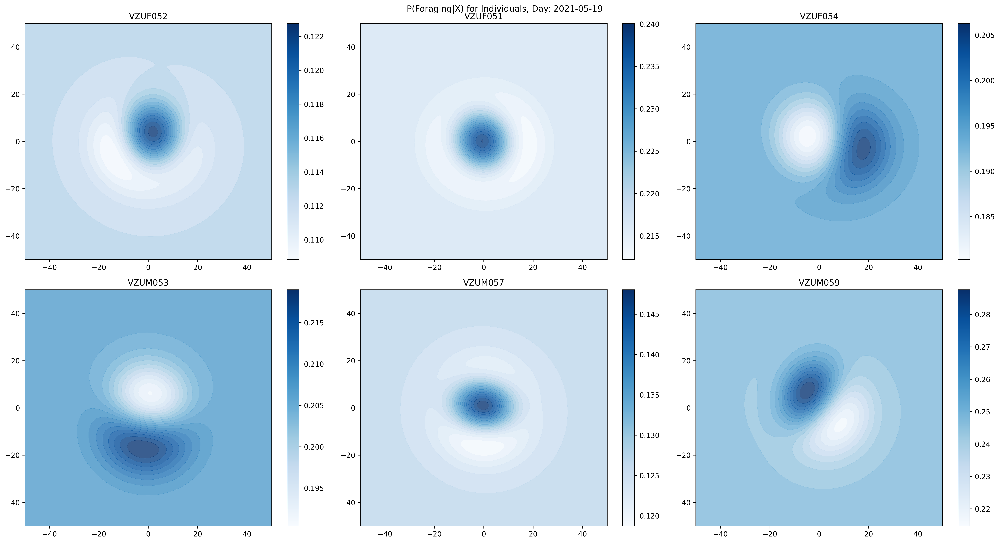

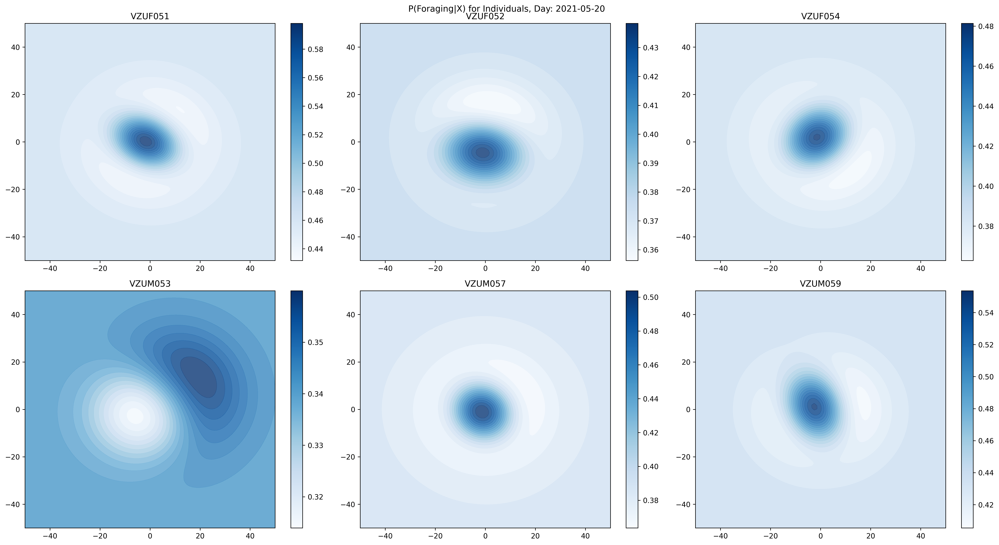

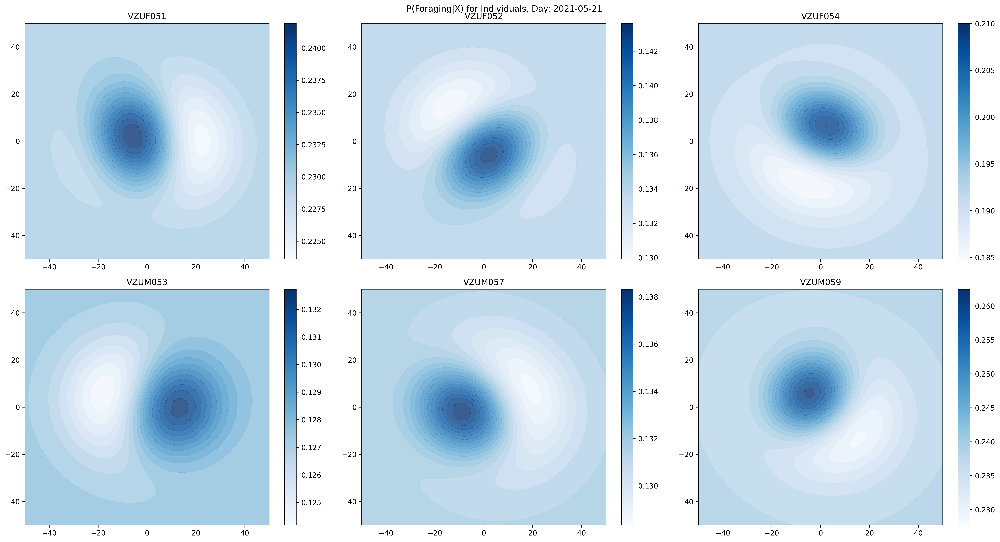

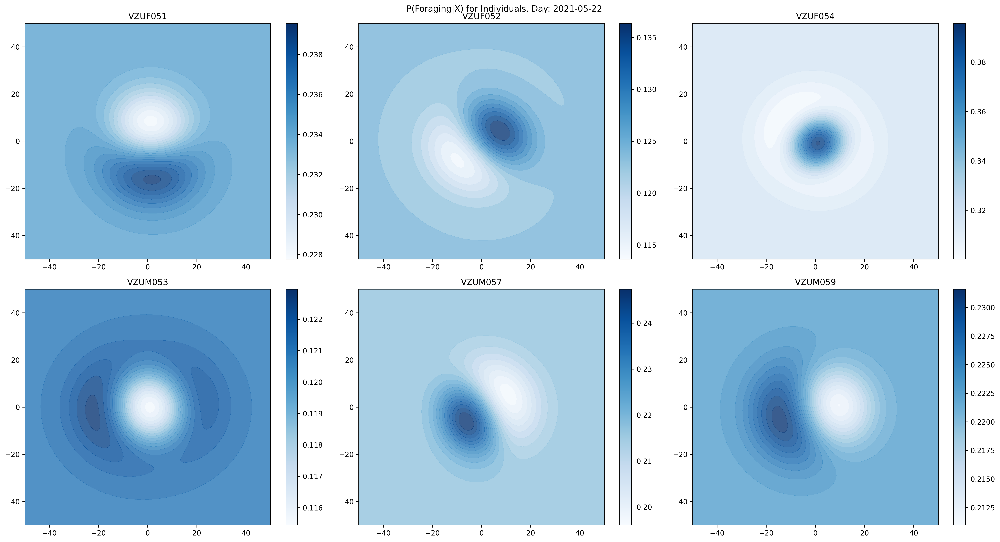

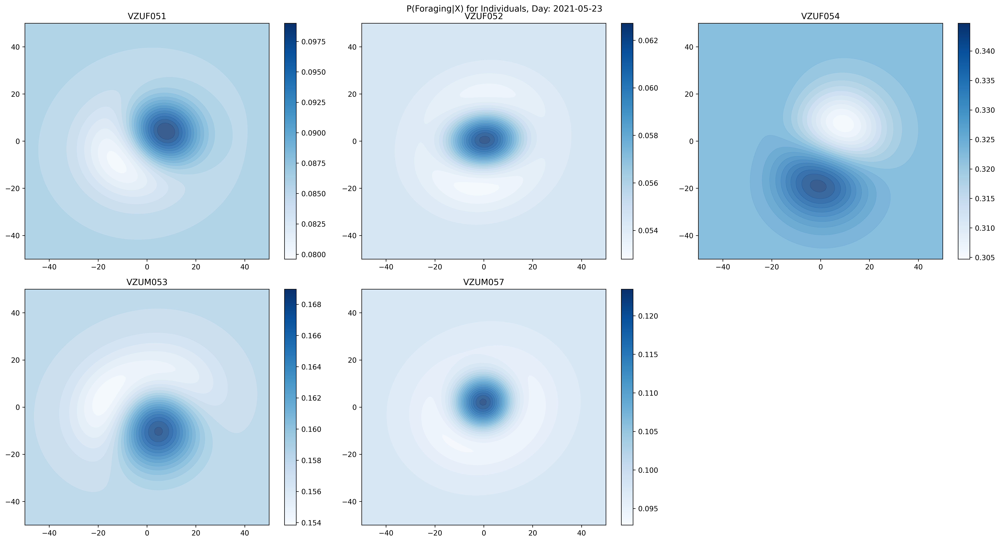

In [ ]:
        
from matplotlib import cm

for day in subset['day'].unique():
    subsets = subset.loc[subset['day']==day]
    fig,axes = plt.subplots(nrows=3,ncols=3,dpi=350,figsize=(20,16))
    axes = axes.flatten()
    i=0
    for ind in subsets['Individual'].unique():
        val_ind = subsets.loc[subsets['Individual']==ind].dropna(axis=0)
        priors = len(val_ind[val_ind['Behavior']=='Vigilance']) / len(val_ind)
        #P(X|Vig)
        x = val_ind.loc[val_ind['Behavior']=='Foraging','Rel_X']
        y = val_ind.loc[val_ind['Behavior']=='Foraging','Rel_Y']
        if len(x) > 3:
            X, Y = np.meshgrid(np.linspace(-50, 50, 100), np.linspace(-50, 50, 100))

            d = np.vstack([x,y]).T
            mean = np.mean(d,axis=0)
            cov = np.cov(d, rowvar=0)
            rv = multivariate_normal(mean,cov)
            P_vig_pos = rv.pdf(pos)


            #Probability of Position 

            x = subsets['Rel_X']
            y = subsets['Rel_Y']
            d = np.vstack([x,y]).T
            mean = np.mean(d,axis=0)
            cov = np.cov(d, rowvar=0)
            rv = multivariate_normal(mean,cov)
            P_group_pos = rv.pdf(pos)

            #P(Vig|X)
            c=0.01
            P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c) 
            
            
            axes[i].contourf(X, Y, P_vig_X,20, alpha=.8,cmap=cm.Blues)
            axes[i].set_title(ind)

            colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
            mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')
            plt.colorbar(mappable, ax=axes[i])


            i = i + 1

        else:
            pass
    for ax in axes[len(subsets['Individual'].unique()):]:
            ax.remove()

    plt.suptitle("P(Foraging|X) for Individuals, " + 'Day: ' + str(day))
    plt.tight_layout()

    
    plt.show()

In [ ]:
subset['Theta'].max()

1.5706827038351152

Time Duration Sampled across:  0 days 02:48:00


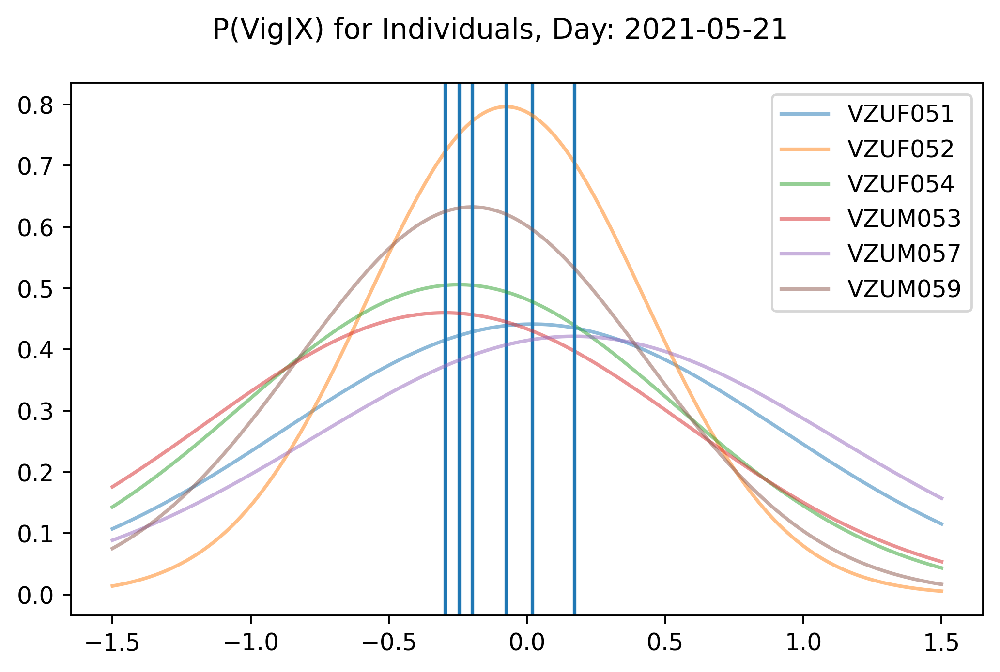

In [ ]:
import datetime
        
from matplotlib import cm
from scipy.stats import norm
day = datetime.date(2021, 5, 21)
subsets = subset.loc[subset['day']==day].reset_index(drop=True)
print('Time Duration Sampled across: ', subsets.iloc[-1,0] -subsets.iloc[0,0] )
  
fig,axes = plt.subplots(dpi=350)    
for ind in subsets['Individual'].unique():
      
    val_ind = subsets.loc[subsets['Individual']==ind].dropna(axis=0)
        
    R = val_ind.loc[val_ind['Behavior']=='Vigilance','R']
    Theta = (val_ind.loc[val_ind['Behavior']=='Vigilance','Theta'])
    X = np.linspace(-1.5,1.5,200) 
    rv = norm(loc=np.mean(Theta), scale=np.var(Theta))
    axes.plot(X,rv.pdf(X), label=ind,alpha=0.5)
    axes.axvline(np.mean(Theta))
plt.legend()
    

plt.suptitle("P(Vig|X) for Individuals, " + 'Day: ' + str(day))
plt.tight_layout()

    
plt.show()


In [ ]:
rv.pdf(X)

array([0.00288353, 0.00318232, 0.00350857, 0.00386441, 0.00425211,
       0.00467405, 0.00513274, 0.00563083, 0.00617112, 0.00675651,
       0.00739007, 0.00807499, 0.0088146 , 0.00961239, 0.01047194,
       0.011397  , 0.01239144, 0.01345923, 0.01460448, 0.0158314 ,
       0.01714432, 0.01854764, 0.02004586, 0.02164352, 0.02334527,
       0.02515574, 0.02707965, 0.02912167, 0.03128651, 0.03357882,
       0.03600321, 0.03856422, 0.04126628, 0.04411371, 0.04711067,
       0.05026116, 0.05356896, 0.05703763, 0.06067044, 0.0644704 ,
       0.06844016, 0.07258204, 0.07689796, 0.08138943, 0.08605748,
       0.09090269, 0.09592512, 0.10112428, 0.10649912, 0.112048  ,
       0.11776864, 0.12365815, 0.12971293, 0.13592874, 0.14230063,
       0.14882292, 0.15548923, 0.16229245, 0.16922471, 0.17627744,
       0.18344133, 0.19070634, 0.19806173, 0.20549605, 0.2129972 ,
       0.2205524 , 0.22814826, 0.23577081, 0.24340551, 0.2510373 ,
       0.25865066, 0.26622965, 0.27375795, 0.28121892, 0.28859

Gaussian Fits

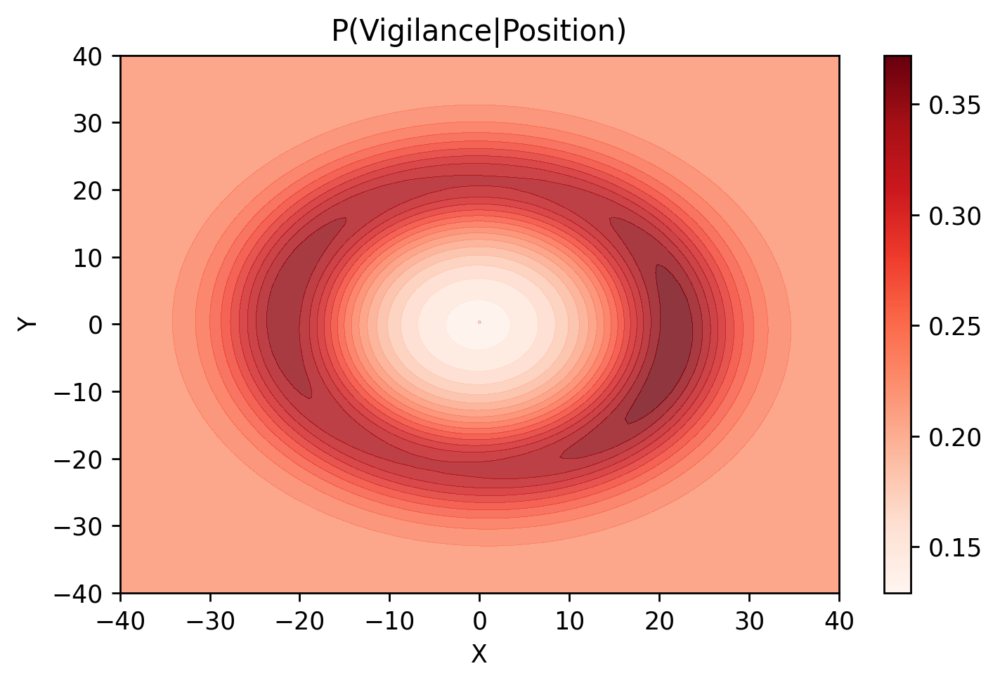

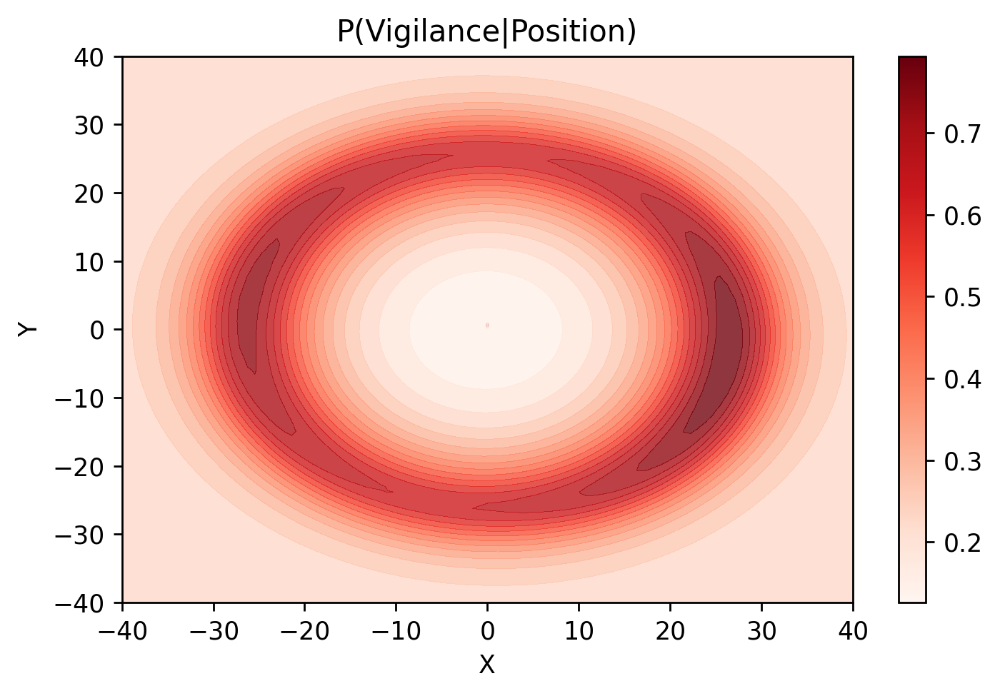

In [ ]:
from scipy.stats import gaussian_kde,multivariate_normal
from matplotlib import cm

X, Y = np.meshgrid(np.linspace(-40, 40, 100), np.linspace(-40, 40, 100))
pos = np.dstack((X, Y))

#Probability of Position given Vigilance
x = subset.loc[subset['Behavior']=='Vigilance','Rel_X']
y = subset.loc[subset['Behavior']=='Vigilance','Rel_Y']
d = np.vstack([x,y]).T
mean = np.mean(d,axis=0)
cov = np.cov(d, rowvar=0)
rv = multivariate_normal(mean,cov)
P_vig_pos = rv.pdf(pos)

#Probability of Position 
x = subset['Rel_X']
y = subset['Rel_Y']
d = np.vstack([x,y]).T
mean = np.mean(d,axis=0)
cov = np.cov(d, rowvar=0)
rv = multivariate_normal(mean,cov)
P_group_pos = rv.pdf(pos)

#X, Y = np.mgrid[-30:30:.1, -30:30:.1]


for c in [0.0001,0.00001]:
    
    P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c) 
    
    fig,axes = plt.subplots(dpi=250)
    axes.contourf(X, Y, P_vig_X,20, alpha=.8,cmap='Reds')

    colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
    mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Reds')
    plt.title('P(Vigilance|Position)')
    plt.colorbar(mappable)
    plt.xlabel('X')
    plt.ylabel('Y')

    plt.tight_layout()
    plt.show()

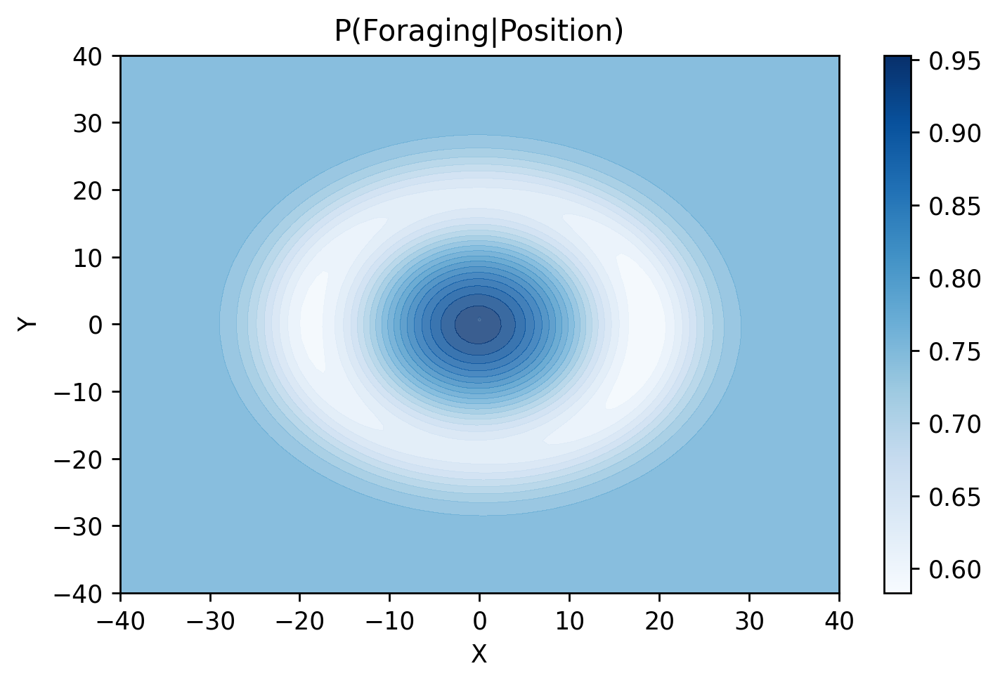

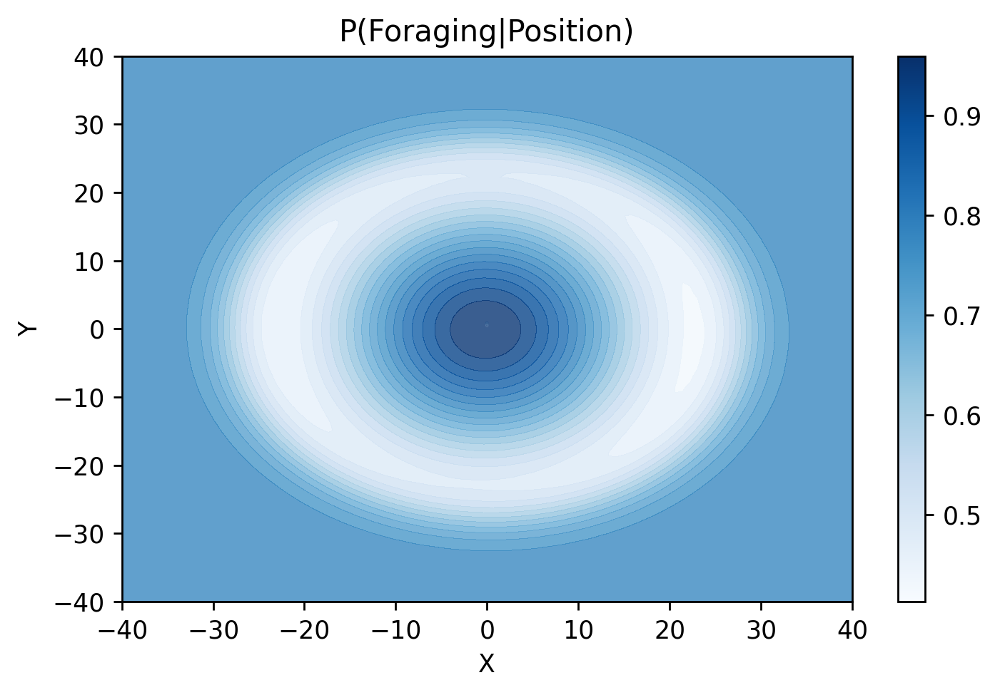

In [ ]:
from scipy.stats import gaussian_kde,multivariate_normal
from matplotlib import cm

X, Y = np.meshgrid(np.linspace(-40, 40, 100), np.linspace(-40, 40, 100))
pos = np.dstack((X, Y))

#Probability of Position given Vigilance
x = subset.loc[subset['Behavior']=='Foraging','Rel_X']
y = subset.loc[subset['Behavior']=='Foraging','Rel_Y']
d = np.vstack([x,y]).T
mean = np.mean(d,axis=0)
cov = np.cov(d, rowvar=0)
rv = multivariate_normal(mean,cov)
P_vig_pos = rv.pdf(pos)

#Probability of Position 
x = subset['Rel_X']
y = subset['Rel_Y']
d = np.vstack([x,y]).T
mean = np.mean(d,axis=0)
cov = np.cov(d, rowvar=0)
rv = multivariate_normal(mean,cov)
P_group_pos = rv.pdf(pos)

#X, Y = np.mgrid[-30:30:.1, -30:30:.1]


for c in [0.0001,0.00001]:
    priors_for = len(subset.loc[subset['Behavior']=='Foraging','Rel_X']) / len(subset['Rel_X'])
    P_vig_X = np.divide((P_vig_pos +c)*priors_for ,P_group_pos + c) 
    
    fig,axes = plt.subplots(dpi=250)
    axes.contourf(X, Y, P_vig_X,20, alpha=.8,cmap='Blues')

    colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
    mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')
    plt.title('P(Foraging|Position)')
    plt.colorbar(mappable)
    plt.xlabel('X')
    plt.ylabel('Y')

    plt.tight_layout()
    plt.show()

In [ ]:
rv.pdf(pos)

array([[2.21753248e-09, 2.92957646e-09, 3.84864157e-09, ...,
        5.65118473e-09, 4.33659764e-09, 3.30922681e-09],
       [2.93561179e-09, 3.87807689e-09, 5.09450496e-09, ...,
        7.45270314e-09, 5.71881954e-09, 4.36381915e-09],
       [3.86384107e-09, 5.10410961e-09, 6.70484143e-09, ...,
        9.77192533e-09, 7.49817642e-09, 5.72135573e-09],
       ...,
       [3.06191941e-09, 4.02971460e-09, 5.27378721e-09, ...,
        5.39255748e-09, 4.12239965e-09, 3.13381377e-09],
       [2.31497482e-09, 3.04656010e-09, 3.98695202e-09, ...,
        4.06156104e-09, 3.10478292e-09, 2.36013734e-09],
       [1.74016643e-09, 2.29000911e-09, 2.99675622e-09, ...,
        3.04146753e-09, 2.32490058e-09, 1.76723119e-09]])

805
149
0.21952486363331097


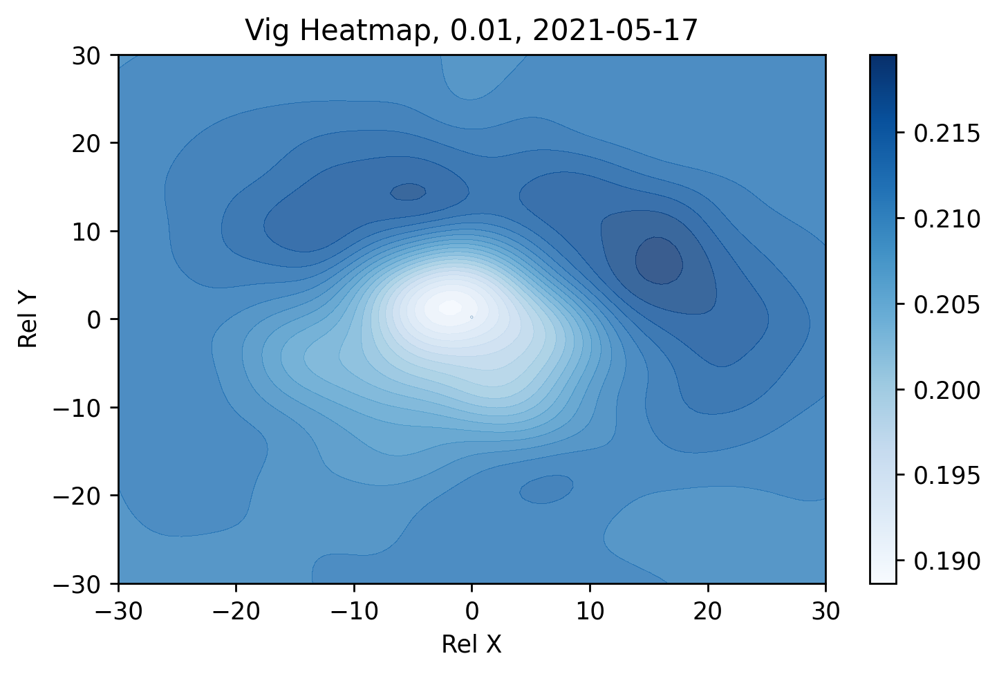

840
128
0.22400446581260613


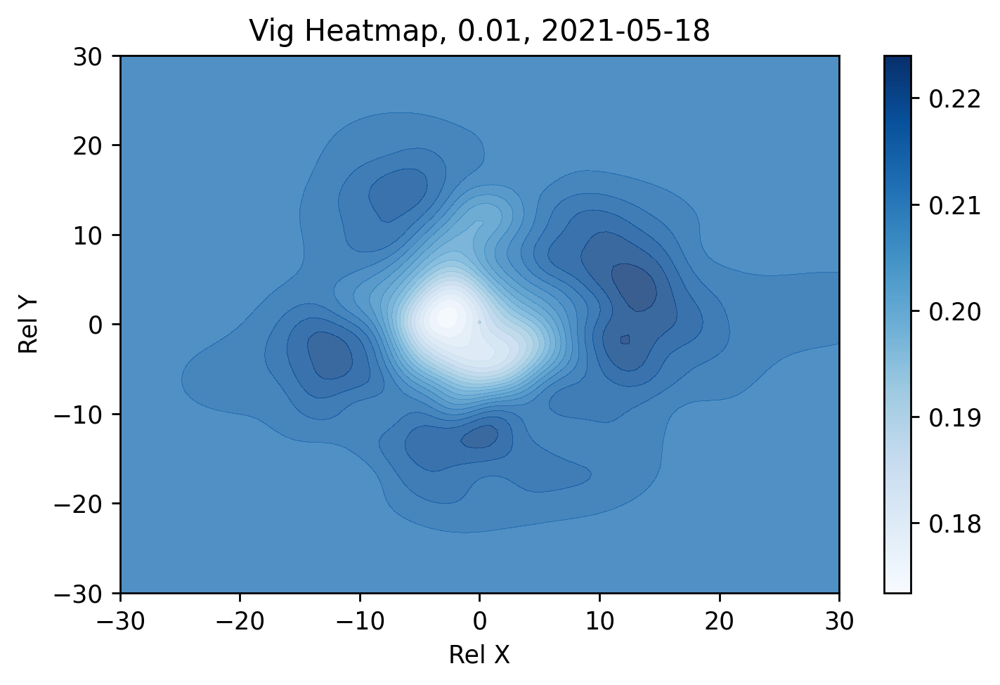

1017
183
0.21817172381500863


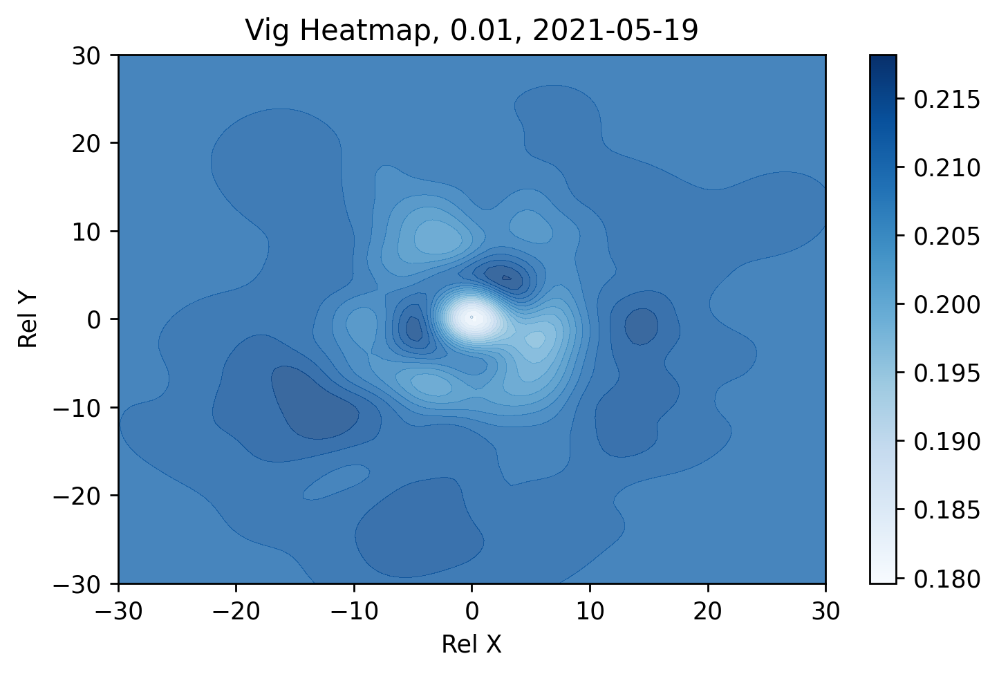

977
376
0.21689849606267333


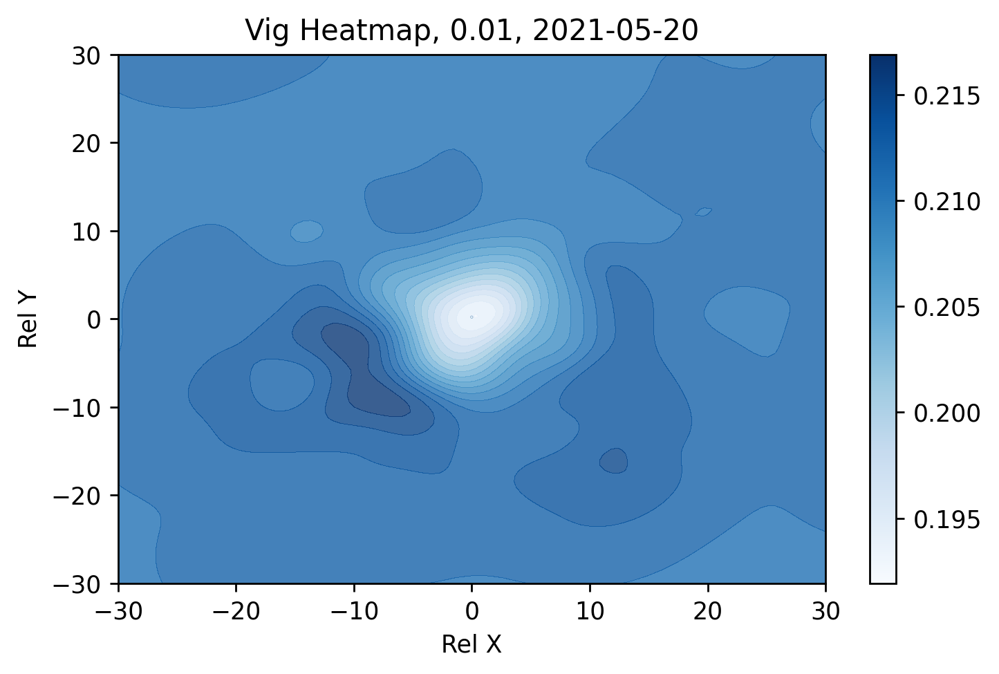

971
175
0.2159911710480466


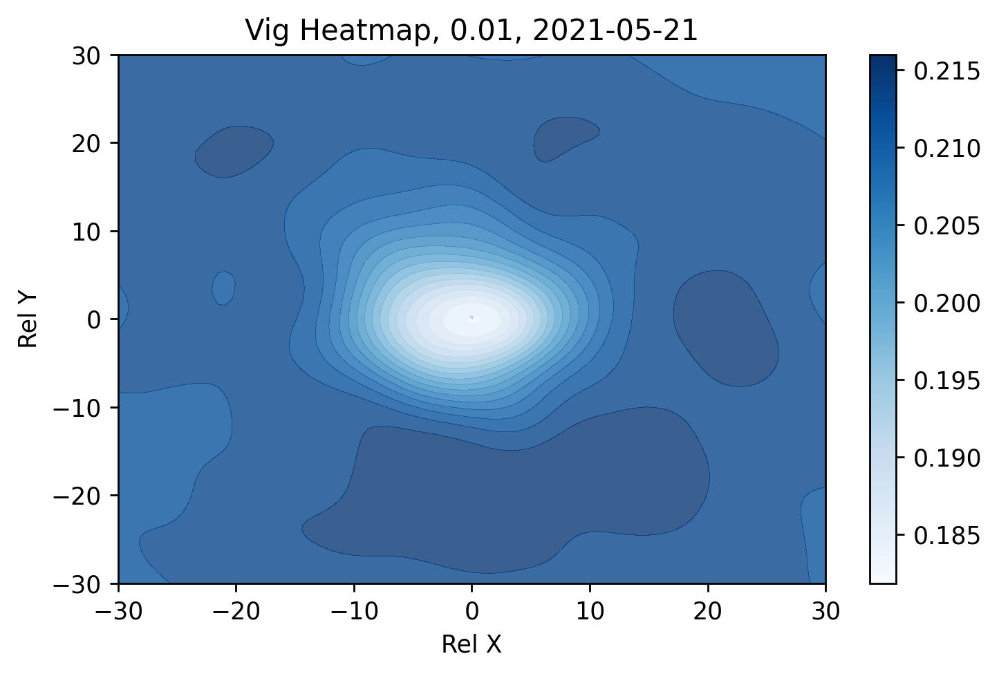

996
210
0.21819917683619527


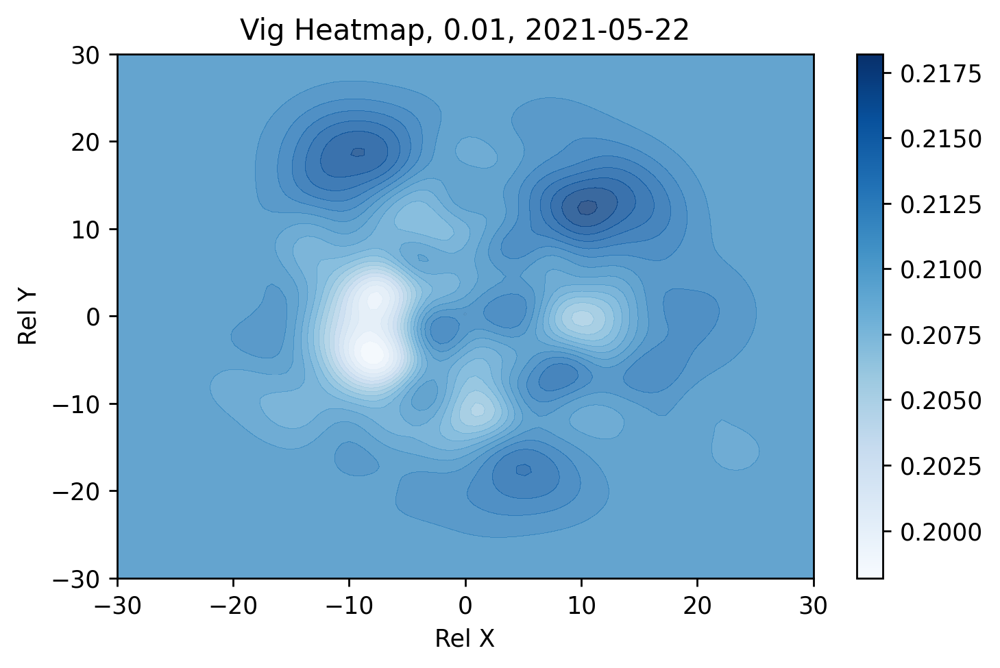

835
118
0.21998634826816563


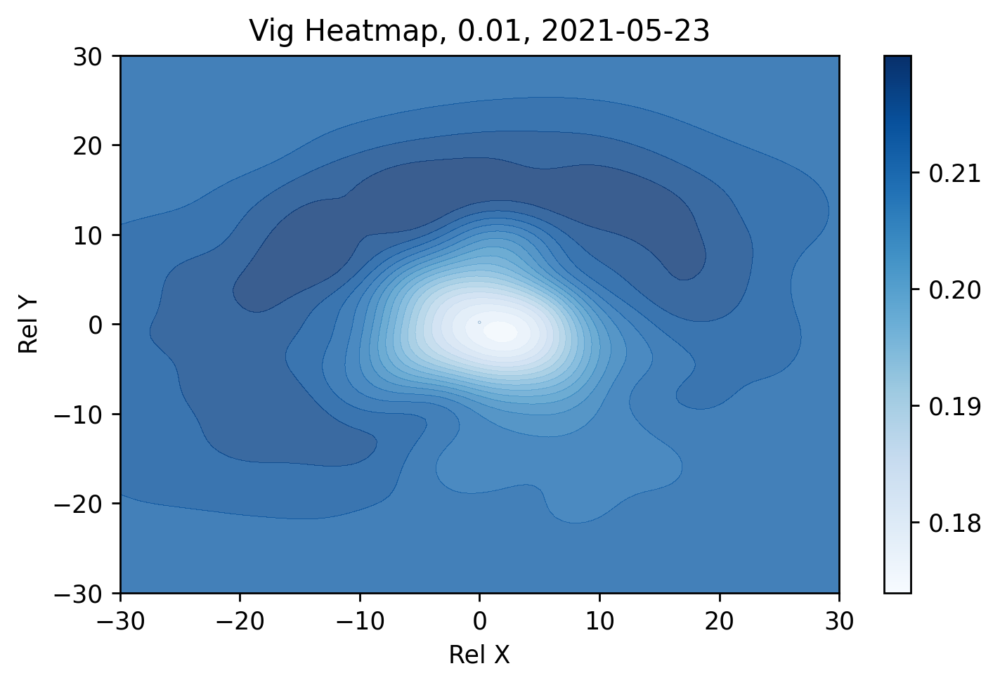

In [ ]:

c= 0.01

for date in subset['day'].unique():
    subsets = subset.loc[subset['day']==date]
    print(len(subsets))
    fig,axes = plt.subplots(dpi=250)
    x = subsets.loc[subsets['Behavior']=='Vigilance','Rel_X']
    y = subsets.loc[subsets['Behavior']=='Vigilance','Rel_Y']
    print(len(x))
    X, Y = np.meshgrid(np.linspace(-30, 30, 100), np.linspace(-30, 30, 100))

    kde = gaussian_kde(np.vstack([x, y]))

    P_vig_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
    
    x = subsets['Rel_X']
    y = subsets['Rel_Y']
    X, Y = np.meshgrid(np.linspace(-30, 30, 100), np.linspace(-30, 30, 100))

    kde = gaussian_kde(np.vstack([x, y]))

    P_group_pos = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
    
    P_vig_X = np.divide((P_vig_pos +c)*priors ,P_group_pos + c)
    print(np.max(P_vig_X))

    axes.contourf(X, Y, P_vig_X,20, alpha=.8,cmap=cm.Blues)
    plt.title('Vig Heatmap, ' + str(c) + ', ' + str(date) )
    axes.set_xlabel('Rel X')
    axes.set_ylabel('Rel Y')
    colors = np.linspace(np.min(P_vig_X),np.max(P_vig_X),20)
    mappable = plt.scatter(np.zeros(20), colors, s=0.0001, c=colors, cmap='Blues')

    plt.colorbar(mappable)
    plt.tight_layout()
    plt.show()

In [ ]:
subset

,Timestamp,Behavior,Individual,Rel_X,Rel_Y,Distances,X_zscore,Y_zscore,day
5,2021-05-17 08:10:57,Foraging,VZUF051,-7.718283,7.120236,0.073845,-0.998294,0.665705,2021-05-17
6,2021-05-17 08:10:57,Vigilance,VZUF052,7.091530,8.274183,0.073845,0.932021,0.772927,2021-05-17
7,2021-05-17 08:10:57,Foraging,VZUF054,-3.563933,4.028599,0.073845,-0.456814,0.378437,2021-05-17
8,2021-05-17 08:10:57,Foraging,VZUM056,11.007938,-21.020245,0.073845,1.442487,-1.949048,2021-05-17
9,2021-05-17 08:10:57,Foraging,VZUM059,-7.112999,1.376178,0.073845,-0.919401,0.131979,2021-05-17
...,...,...,...,...,...,...,...,...,...
845,2021-05-23 10:57:18,Foraging,VZUF051,5.336298,-6.032935,0.462420,0.629822,-0.738628,2021-05-23
846,2021-05-23 10:57:18,Foraging,VZUF052,-0.777003,8.379570,0.462420,-0.074967,1.166358,2021-05-23
847,2021-05-23 10:57:18,Vigilance,VZUF054,-15.345529,5.849868,0.462420,-1.754541,0.831992,2021-05-23
848,2021-05-23 10:57:18,Foraging,VZUM053,10.560998,-11.994672,0.462420,1.232166,-1.526627,2021-05-23


# Time Discrete

In [ ]:

steptime = 120

times = sorted(data['Timestamp'].unique())[::steptime]
#value = value.set_index('Timestamp').loc[sorted(value['Timestamp'].unique())[::steptime],:].reset_index()
discrete_space_times,centroid_pos = [times[0]],[]

prev_pos = data.loc[data['Timestamp'] == times[0]].dropna()
for time in times[1:]:
    
    prev_centroid = np.sum(prev_pos[['X','Y']],axis=0)/prev_pos.shape[0]
    new_pos = data.loc[data['Timestamp'] == time].dropna()
    new_centroid = np.sum(new_pos[['X','Y']],axis=0)/new_pos.shape[0]
    prev_pos = new_pos.dropna()
    discrete_space_times.append(time)
    centroid_pos.append(new_centroid)
discrete_space_times = [pd.to_datetime(i) for i in discrete_space_times]

In [ ]:
len(group_direction),len(discrete_space_times)

(172, 173)

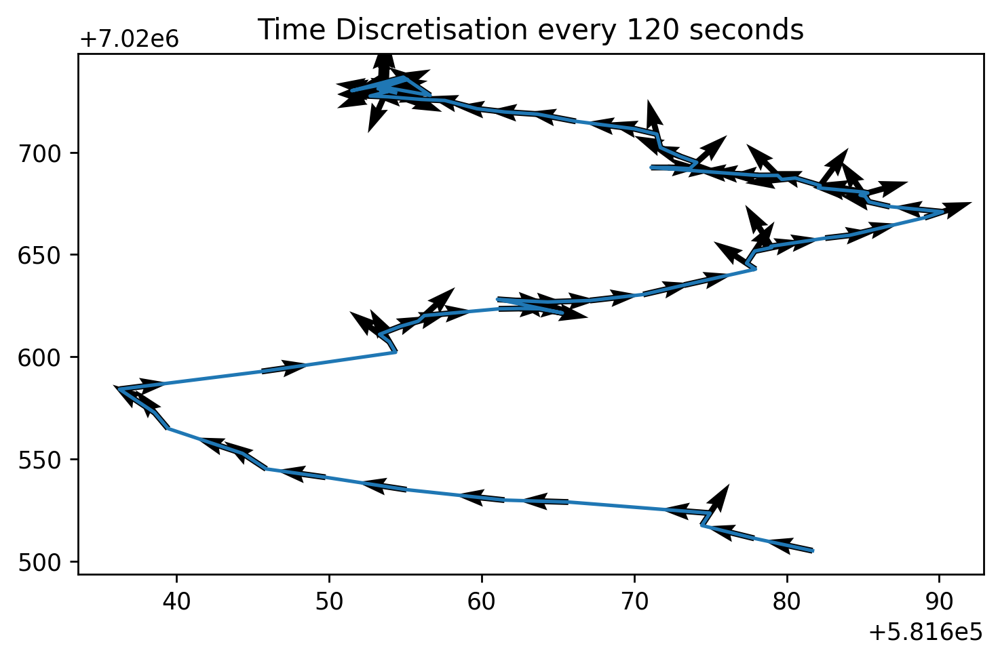

In [ ]:
centroid_mov =pd.DataFrame()
centroid_mov['Timestamp'] = discrete_space_times[:-1]
centroid_mov['Centroid_X'] = [i[0] for i in centroid_pos]
centroid_mov['Centroid_Y'] = [i[1] for i in centroid_pos]
dirs = [(centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3]) / np.sqrt(np.sum((centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3])**2))  for i in range(centroid_mov.shape[0]-1) ]
centroid_mov = centroid_mov.iloc[0:-1,:]
centroid_mov['Dir_X'] = [i[0] for i in dirs]
centroid_mov['Dir_Y'] = [i[1] for i in dirs]

fig,ax= plt.subplots(dpi=250)
#ax.set_aspect('equal')
plt.title('Time Discretisation every ' + str(steptime) + ' seconds')
ax.plot(centroid_mov.iloc[:,1],centroid_mov.iloc[:,2])
ax.quiver(centroid_mov.iloc[:,1],centroid_mov.iloc[:,2],centroid_mov.iloc[:,3],centroid_mov.iloc[:,4],angles='xy')
plt.tight_layout()
plt.show()



In [ ]:
data_discrete =  data.set_index('Timestamp').loc[centroid_mov['Timestamp']].reset_index()
data_discrete = data_discrete.replace([np.inf, -np.inf], np.nan)
data_discrete = data_discrete.dropna(axis=0).reset_index(drop=True)

data_discrete = data_discrete.drop(['lat','lon','height-msl'],axis=1)
corrected_data_discrete = pd.DataFrame()
for time in data_discrete['Timestamp'].unique():
    
    group_data = data_discrete.loc[data_discrete['Timestamp']==time]
    centroid_data = centroid_mov.loc[centroid_mov['Timestamp']==time]
    new_df =group_data.loc[:,['Timestamp','Behavior','Individual']]
    new_df['Rel_X'] = group_data['X'] - centroid_data['Centroid_X'].values
    new_df['Rel_Y'] = group_data['Y'] - centroid_data['Centroid_Y'].values
    
    direction_angle = np.arctan(( centroid_data['Dir_Y']/ centroid_data['Dir_X']).values)
    Rel_X = new_df['Rel_X']*np.cos(direction_angle) - new_df['Rel_Y']*np.sin(direction_angle)
    Rel_Y = new_df['Rel_X']*np.sin(direction_angle) + new_df['Rel_Y']*np.cos(direction_angle)
    new_df['Rel_X'] = Rel_X
    new_df['Rel_Y'] = Rel_Y
    new_df['X_zscore'] = (new_df['Rel_X'] - np.mean(new_df['Rel_X'])) / np.std(new_df['Rel_X']) 
    new_df['Y_zscore'] = (new_df['Rel_Y'] - np.mean(new_df['Rel_Y'])) / np.std(new_df['Rel_Y']) 
    
    corrected_data_discrete = pd.concat([corrected_data_discrete,new_df],axis=0)

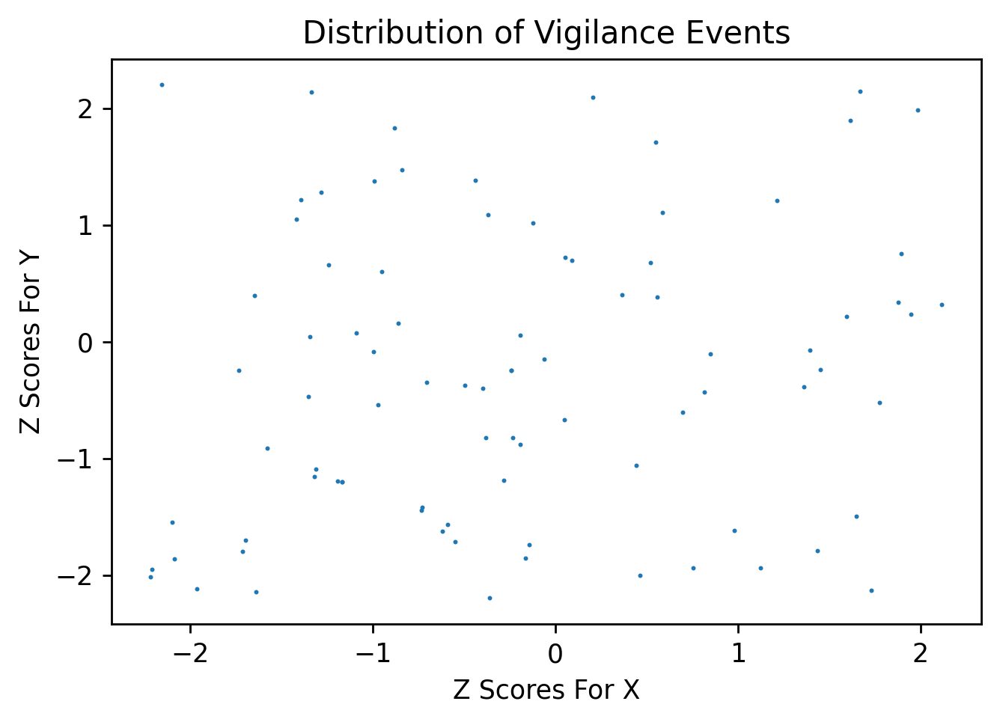

In [ ]:
fig,ax= plt.subplots(dpi=250)
ax.set_title('Distribution of Vigilance Events')
ax.set_xlabel('Z Scores For X')
ax.set_ylabel('Z Scores For Y')
vig_data = corrected_data_discrete[corrected_data_discrete['Behavior']=='Vigilance']
ax.scatter(vig_data['X_zscore'],vig_data['Y_zscore'],s=0.5)

Duration of data 52128
Duration of Simultaneous data 50855
2021-05-17T08:09:57.000000000


Duration of data 54271
Seconds removed:  3
Duration of Simultaneous data 53206
2021-05-18T08:06:30.000000000


Duration of data 63003
Duration of Simultaneous data 62076
2021-05-19T08:07:02.000000000


Duration of data 63116
Duration of Simultaneous data 61937
2021-05-20T08:07:23.000000000


Duration of data 63302
Duration of Simultaneous data 62056
2021-05-21T08:07:01.000000000


Duration of data 63251
Duration of Simultaneous data 62286
2021-05-22T08:06:27.000000000


Duration of data 52604
Duration of Simultaneous data 51345
2021-05-23T08:08:18.000000000




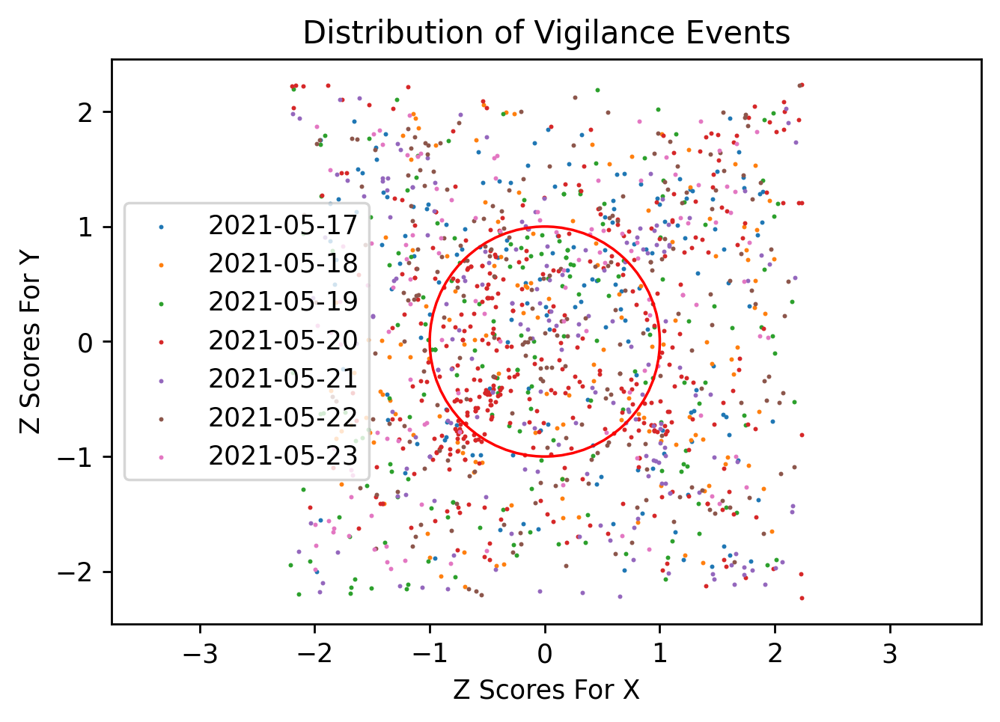

In [ ]:
k = 'ZU_2021_1' #ZGroups
J = ['2021-05-17','2021-05-18','2021-05-19','2021-05-20','2021-05-21','2021-05-22','2021-05-23'] #Day
fig,ax= plt.subplots(dpi=250)
ax.set_title('Distribution of Vigilance Events')
ax.set_xlabel('Z Scores For X')
ax.set_ylabel('Z Scores For Y')
vig_events,vig_events_lims = [],[]
for j in J:
    data = pd.read_csv(ProcessedPath + str(k) + '/GPS_Days/'+ j,index_col=0)
    data = sync_gps_simultaneous(data,k,j)
    
    steptime = 60
    times = sorted(data['Timestamp'].unique())[::steptime]
    print(times[0])
    print('\n')

    

    discrete_space_times,centroid_pos = [times[0]],[]

    prev_pos = data.loc[data['Timestamp'] == times[0]].dropna(axis=0)
    for time in times[1:]:

        prev_centroid = np.sum(prev_pos[['X','Y']],axis=0)/prev_pos.shape[0]
        new_pos = data.loc[data['Timestamp'] == time].dropna(axis=0)
        new_centroid = np.sum(new_pos[['X','Y']],axis=0)/new_pos.shape[0]
        prev_pos = new_pos.dropna()
        discrete_space_times.append(time)
        centroid_pos.append(new_centroid)
        
    discrete_space_times = [pd.to_datetime(i) for i in discrete_space_times]
    centroid_mov =pd.DataFrame()
    centroid_mov['Timestamp'] = discrete_space_times[:-1]
    centroid_mov['Centroid_X'] = [i[0] for i in centroid_pos]
    centroid_mov['Centroid_Y'] = [i[1] for i in centroid_pos]
    dirs = [(centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3]) / np.sqrt(np.sum((centroid_mov.iloc[i+1,1:3] - centroid_mov.iloc[i,1:3])**2))  for i in range(centroid_mov.shape[0]-1) ]
    centroid_mov = centroid_mov.iloc[0:-1,:]
    centroid_mov['Dir_X'] = [i[0] for i in dirs]
    centroid_mov['Dir_Y'] = [i[1] for i in dirs]

    
    data_discrete =  data.set_index('Timestamp').loc[centroid_mov['Timestamp']].reset_index()
    data_discrete = data_discrete.replace([np.inf, -np.inf], np.nan)
    data_discrete = data_discrete.dropna(axis=0).reset_index(drop=True)

    data_discrete = data_discrete.drop(['lat','lon','height-msl'],axis=1)
    corrected_data_discrete = pd.DataFrame()
    for time in data_discrete['Timestamp'].unique():
    
        group_data = data_discrete.loc[data_discrete['Timestamp']==time]
        centroid_data = centroid_mov.loc[centroid_mov['Timestamp']==time]
        new_df =group_data.loc[:,['Timestamp','Behavior','Individual']]
        new_df['Rel_X'] = group_data['X'] - centroid_data['Centroid_X'].values
        new_df['Rel_Y'] = group_data['Y'] - centroid_data['Centroid_Y'].values

        direction_angle = np.arctan(( centroid_data['Dir_Y']/ centroid_data['Dir_X']).values)
        Rel_X = new_df['Rel_X']*np.cos(direction_angle) - new_df['Rel_Y']*np.sin(direction_angle)
        Rel_Y = new_df['Rel_X']*np.sin(direction_angle) + new_df['Rel_Y']*np.cos(direction_angle)
        new_df['Rel_X'] = Rel_X
        new_df['Rel_Y'] = Rel_Y
        new_df['X_zscore'] = (new_df['Rel_X'] - np.mean(new_df['Rel_X'])) / np.std(new_df['Rel_X']) 
        new_df['Y_zscore'] = (new_df['Rel_Y'] - np.mean(new_df['Rel_Y'])) / np.std(new_df['Rel_Y']) 

        corrected_data_discrete = pd.concat([corrected_data_discrete,new_df],axis=0)

    vig_data = corrected_data_discrete[corrected_data_discrete['Behavior']=='Vigilance']
    vig_events_lims.append(len(vig_data[np.sqrt(vig_data['X_zscore']**2 + vig_data['Y_zscore']**2)<=1]))
    vig_events.append(len(vig_data))
    ax.scatter(vig_data['X_zscore'],vig_data['Y_zscore'],s=0.5,label=j)

cir = plt.Circle((0, 0), 1, color='r',fill=False)
ax.set_aspect('equal', adjustable='datalim')
ax.add_patch(cir)
plt.legend()
plt.show()


In [ ]:
sum(vig_events_lims)/ sum( vig_events)

0.2944960686204432

In [ ]:
from sklearn.decomposition import PCA
stepspace = 10
def discretize_space(value,stepspace):
    times = sorted(value['Timestamp'].unique())
    prev_pos = value.loc[0,:]

    
steptime = 30
def discretize_time(value,steptime): 
    times = sorted(value['Timestamp'].unique())[::steptime]
    value = value.set_index('Timestamp').loc[sorted(value['Timestamp'].unique())[::steptime],:].reset_index()
    return value
    

def Elongation(value):
    
    pca = PCA(n_components=2)
    pca.fit(value.loc[:,['X','Y']])
    PC1 = np.max(pca.explained_variance_)
    PC2 = np.min(pca.explained_variance_)
    
    return 1 - (PC2/PC1)

def Spread(value):
    square_sum = 0
    N = value.shape[0]
    for i in value['Individual'].unique():
        element = value.loc[value['Individual']==i,['X','Y']]
        diff =  value.loc[:,['X','Y']] - element.values
        square_sum = square_sum +  np.sum(np.sum(np.square(diff)))
    return (1/(N*(N-1)))*np.sqrt(square_sum)

def Group_speed(time,value):
    N = value.shape[0]
    next_value = dfnew.loc[dfnew['Timestamp']==str(pd.to_datetime(time)+pd.Timedelta(seconds=1))]                                  
    diff =  (next_value.loc[:,['X','Y']].values/N - value.loc[:,['X','Y']].values/N)
    diff_square_sum = np.sum(np.square(diff)[:])
    return np.sqrt(diff_square_sum),np.sum(value.loc[:,['X','Y']].values/N,axis=0)


def extract_move(dfnew):
    
    times = sorted(dfnew['Timestamp'].unique())[30:-30]

    elongation,spread,group_speed = [],[],[]            
    x_centroid,y_centroid = [],[]
    
    for i in times:
        try:
            value = dfnew.loc[dfnew['Timestamp']==i]
            elongation.append(Elongation(value))
            spread.append(Spread(value))
            speed,centroid_pos = Group_speed(i,value)        
            group_speed.append(speed)
            x_centroid.append(centroid_pos[0])
            y_centroid.append(centroid_pos[1])
        except:
            print(i)
    
    movement_metrics = pd.DataFrame()
    movement_metrics['Timestamp'] = times
    movement_metrics['elongation'] = elongation
    movement_metrics['Group_speed'] = group_speed
    movement_metrics['X_Centroid'] = x_centroid
    movement_metrics['Y_Centroid'] = y_centroid
    movement_metrics['Spread'] = spread
    
    return movement_metrics

IndentationError: expected an indented block (<ipython-input-27-8abbb9242f5c>, line 9)

In [ ]:
metrics = extract_move(dfnew)